## Comparing MUC5AC/Surface foveolar-like cells in health and disease

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter
import gseapy

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

import gseapy

In [2]:
import random

In [3]:
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.0 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3


In [4]:
sc.set_figure_params(dpi = 100, dpi_save=600)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [5]:
gene_set_names = gseapy.get_library_name(organism='Human')
print(gene_set_names)

['ARCHS4_Cell-lines', 'ARCHS4_IDG_Coexp', 'ARCHS4_Kinases_Coexp', 'ARCHS4_TFs_Coexp', 'ARCHS4_Tissues', 'Achilles_fitness_decrease', 'Achilles_fitness_increase', 'Aging_Perturbations_from_GEO_down', 'Aging_Perturbations_from_GEO_up', 'Allen_Brain_Atlas_10x_scRNA_2021', 'Allen_Brain_Atlas_down', 'Allen_Brain_Atlas_up', 'Azimuth_2023', 'Azimuth_Cell_Types_2021', 'BioCarta_2013', 'BioCarta_2015', 'BioCarta_2016', 'BioPlanet_2019', 'BioPlex_2017', 'CCLE_Proteomics_2020', 'CORUM', 'COVID-19_Related_Gene_Sets', 'COVID-19_Related_Gene_Sets_2021', 'Cancer_Cell_Line_Encyclopedia', 'CellMarker_Augmented_2021', 'ChEA_2013', 'ChEA_2015', 'ChEA_2016', 'ChEA_2022', 'Chromosome_Location', 'Chromosome_Location_hg19', 'ClinVar_2019', 'DSigDB', 'Data_Acquisition_Method_Most_Popular_Genes', 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019', 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019', 'Descartes_Cell_Types_and_Tissue_2021', 'Diabetes_Perturbations_GEO_2022', 'DisGeNET', 'Disease_Perturbations_from_GEO

### Import data

In [6]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/pooled_compartments/Epi_SI_AP.pooled_healthy_disease.remapped.allgenes.fine_annot.no_doublets.20230418.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 221900 × 18485
    var: 'gene_ids-0-0-query', 'feature_type-0-0-query', 'mito-0-0-query', 'ribo-0-0-query', 'hb-0-0-query', 'n_counts-0-0-query', 'n_counts_raw-0-0-query', 'n_counts_spliced-0-0-query', 'n_counts_unspliced-0-0-query', 'n_cells-0-0-query', 'n_cells_raw-0-0-query', 'n_cells_spliced-0-0-query', 'n_cells_unspliced-0-0-query', 'cc-0-0-query', 'ig-0-0-query', 'tcr-0-0-query', 'gene_id-1-0-query', 'mt-1-0-query', 'ensmbl_id-colon-1-0-query', 'n_cells_by_counts-colon-1-0-query', 'mean_counts-colon-1-0-query', 'pct_dropout_by_counts-colon-1-0-query', 'total_counts-colon-1-0-query', 'n_cells_by_counts-ileum-1-0-query', 'mean_counts-ileum-1-0-query', 'pct_dropout_by_counts-ileum-1-0-query', 'total_counts-ileum-1-0-query', 'gene_ids-reference', 'feature_type-reference', 'mito-reference', 'ribo-reference', 'hb-reference', 'n_counts-reference', 'n_counts_raw-reference', 'n_counts_spliced-reference', 'n_counts_unspliced-reference', 'n_cells-referen

In [8]:
adata.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_compartments/Epi_SI_AP.pooled_healthy_disease.remapped.allgenes.fine_annot.no_doublets.20230418.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (3,5,6,8,9,11,12,14,62,63,64,65,66,67,70,72,73,75,78,82,83,84,86,88,91,92,93,94,95,100,101,102,103,106,107,109,110,112,113,114,118,120,121,122,123,124,125,126,127,128,130,131,133,134,135) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [9]:
adata

AnnData object with n_obs × n_vars = 221900 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_sp

In [10]:
adata.X.max()

9.066531

### Explore data

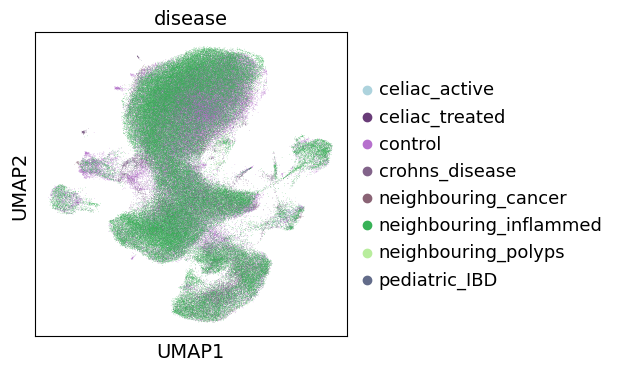

In [11]:
sc.pl.umap(adata,color='disease')

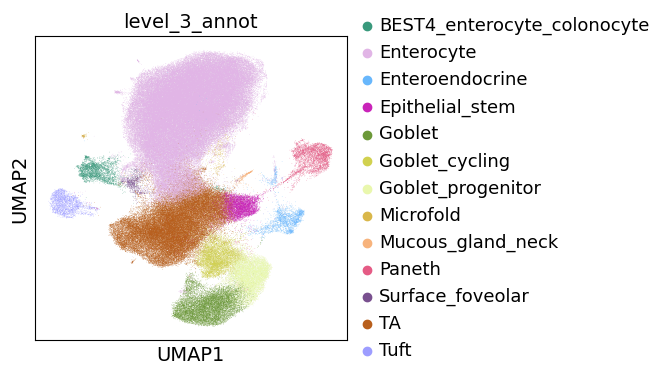

In [12]:
sc.pl.umap(adata,color='level_3_annot')

## Analysis

### Run DGE for marker genes across all subsets

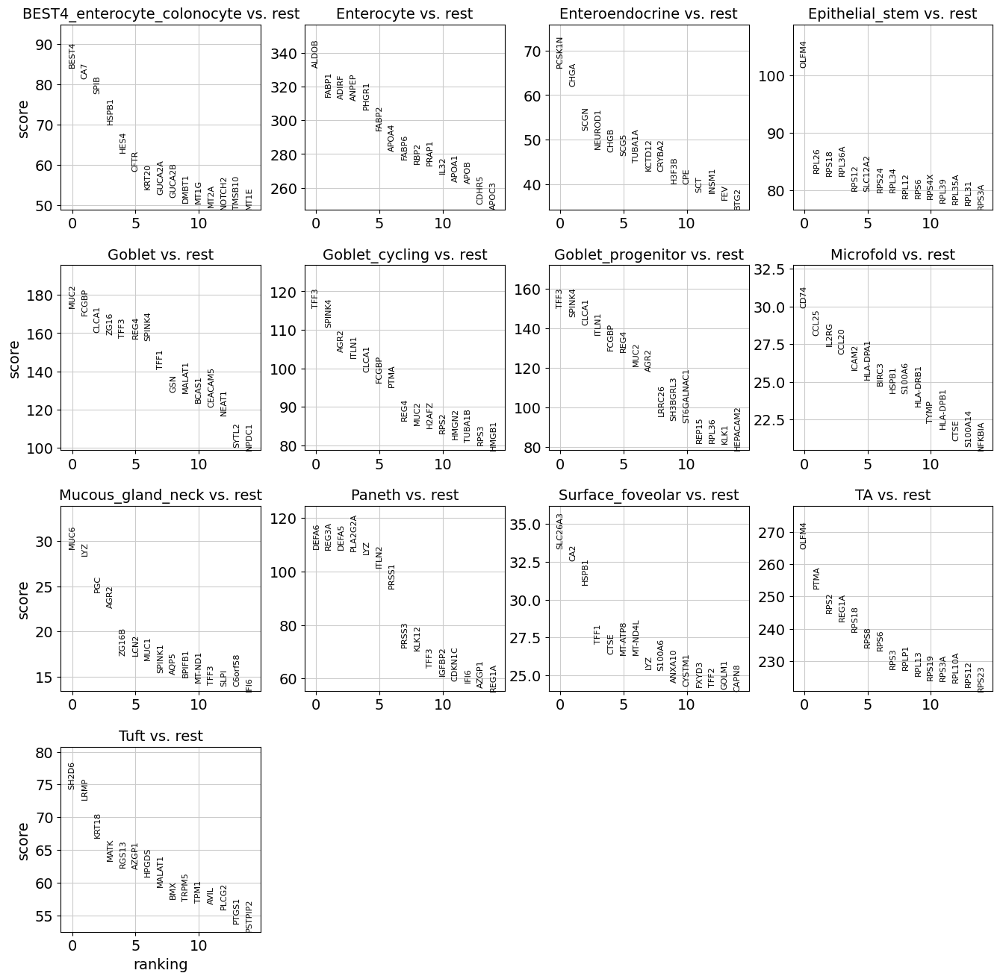

In [13]:
adata.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(adata, 'level_3_annot', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

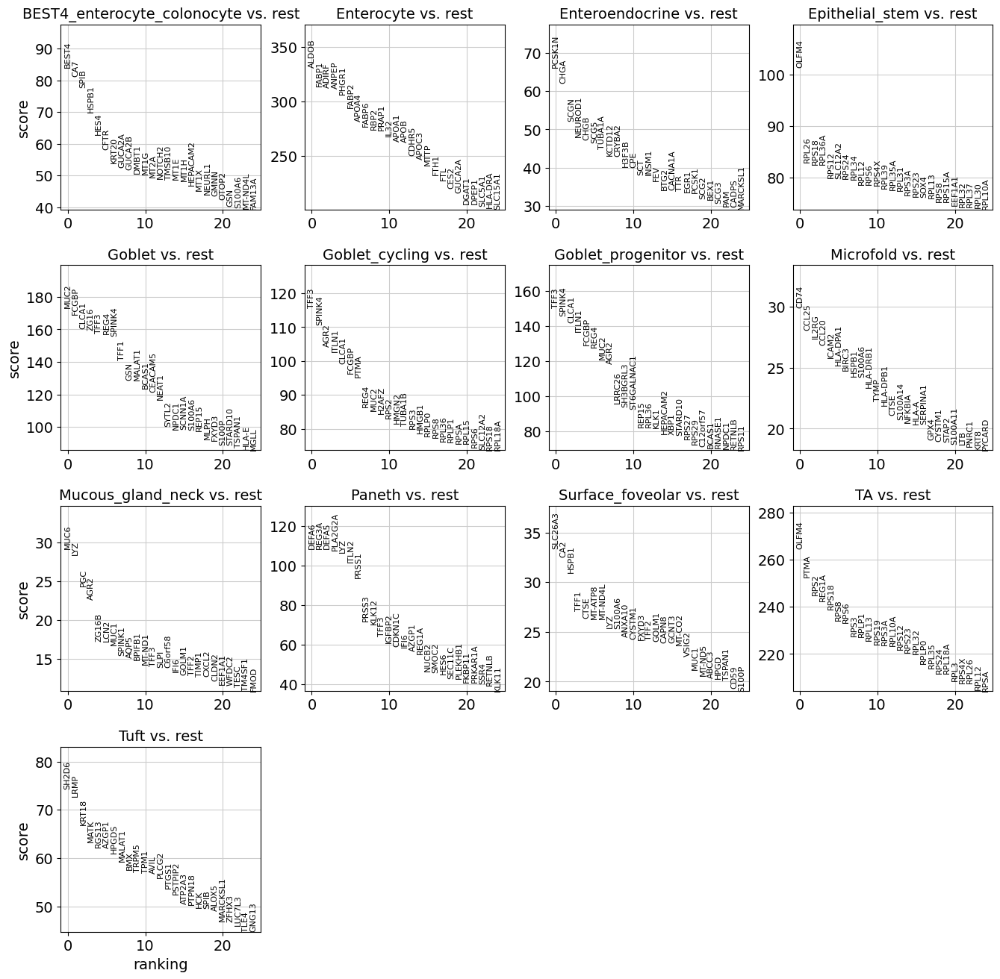

In [14]:
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [15]:
list(adata.obs.level_3_annot.unique())

['TA',
 'Microfold',
 'Enterocyte',
 'Epithelial_stem',
 'Goblet_cycling',
 'Goblet_progenitor',
 'BEST4_enterocyte_colonocyte',
 'Goblet',
 'Tuft',
 'Enteroendocrine',
 'Surface_foveolar',
 'Paneth',
 'Mucous_gland_neck']

In [16]:
adata.obs.level_3_annot = adata.obs.level_3_annot.cat.reorder_categories([
   'BEST4_enterocyte_colonocyte',
    'Enterocyte',
    'Enteroendocrine',
    'Epithelial_stem',
     'Goblet',
 'Goblet_cycling',
 'Goblet_progenitor',
    'Surface_foveolar',
    'Mucous_gland_neck',
    'Microfold',
     'Paneth',
    'TA',
 'Tuft',
 
 

 ], ordered=True)

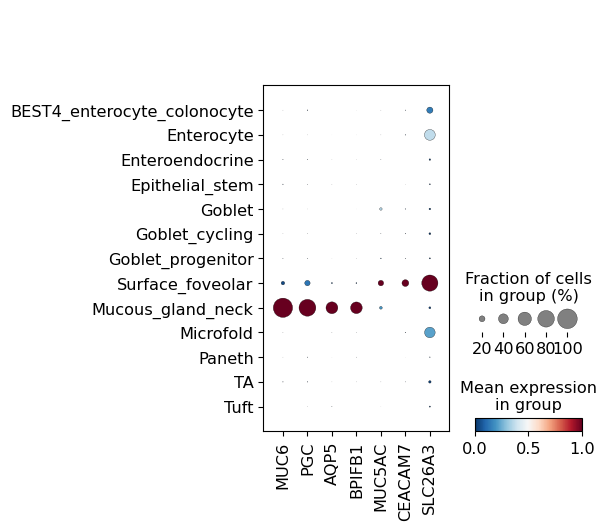

In [17]:
#plot MUC6 (INFLARE) and surface foveolar/SF-like cell markers - Figure 3b
sc.pl.dotplot(adata,var_names=['MUC6','PGC','AQP5','BPIFB1','MUC5AC','CEACAM7','SLC26A3'],groupby='level_3_annot',color_map='RdBu_r', standard_scale='var',save='MUC6_MUC5AC_markers.pdf')

In [18]:
#Prepare categories for downsampling (per donor_celltype combination)
adata.obs['donor_celltype']=adata.obs['donorID_unified'].astype(str)+'_'+adata.obs['level_3_annot'].astype(str)
adata.obs.donor_celltype.value_counts()

D207_Enterocyte           22733
D207_TA                    9010
D168_Enterocyte            8924
D191_TA                    6877
D11_Enterocyte             6846
                          ...  
D46_Goblet                    1
D214_Mucous_gland_neck        1
D46_Goblet_cycling            1
D47_Paneth                    1
D161_Mucous_gland_neck        1
Name: donor_celltype, Length: 943, dtype: int64

### Isolate surface foveolar cells for analysis

In [19]:
muc5ac = adata[adata.obs.level_3_annot.isin(['Surface_foveolar'])].copy()

In [20]:
muc5ac

AnnData object with n_obs × n_vars = 941 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_splic

#### Subcluster

In [21]:
sc.pp.neighbors(muc5ac, use_rep="X_scANVI")
sc.tl.umap(muc5ac)

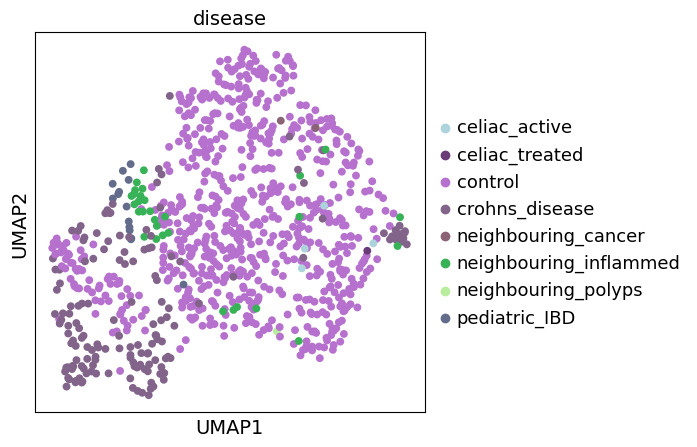

In [22]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(muc5ac,color='disease')

In [23]:
del muc5ac.uns['disease_colors']

In [24]:
muc5ac.obs.disease = muc5ac.obs.disease.cat.reorder_categories(['control','crohns_disease','pediatric_IBD',
                        'neighbouring_inflammed','neighbouring_polyps','celiac_active','celiac_treated','neighbouring_cancer'], ordered=True)

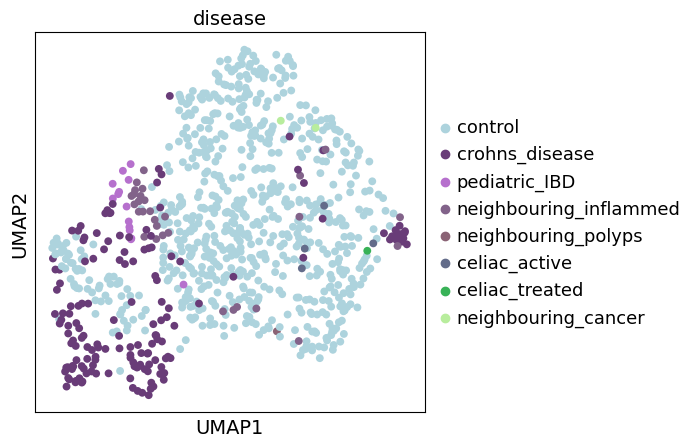

In [25]:
#plot UMAP coloured by disease -  Extended data 6b
sc.pl.umap(muc5ac,color='disease',palette = ['#ADD3DD','#693C78',
'#B670CD', '#82638a','#8a6375','#636c8a','#38B257','#b8ed9d'],save='muc5ac_diseaseumap.pdf')

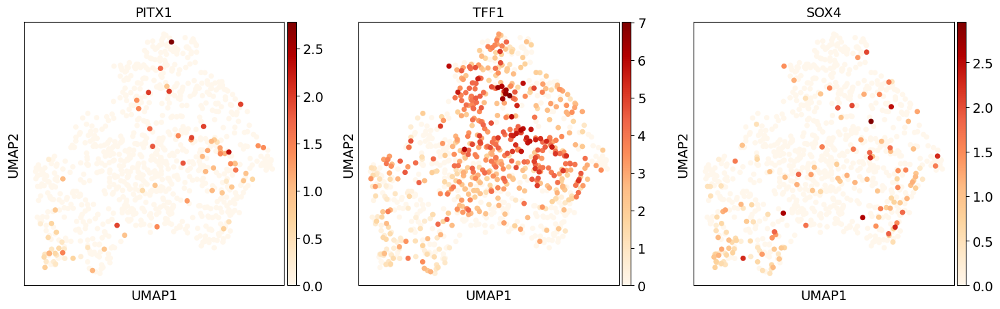

In [26]:
sc.pl.umap(muc5ac,color=['PITX1','TFF1','SOX4'],cmap='OrRd')

##### Plot some relevant marker genes

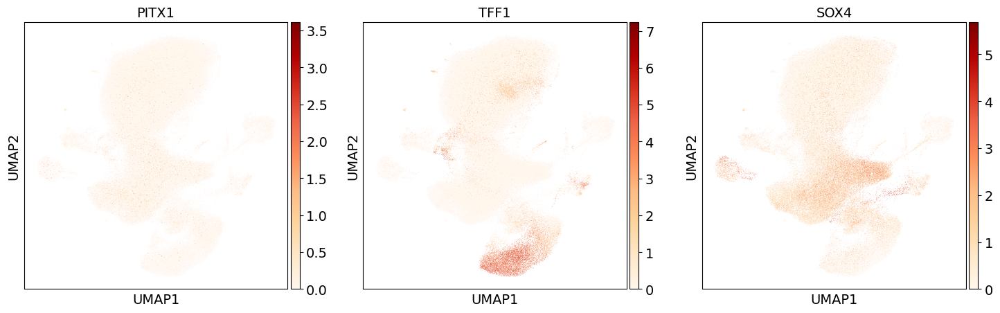

In [27]:
sc.pl.umap(adata,color=['PITX1','TFF1','SOX4'],cmap='OrRd')

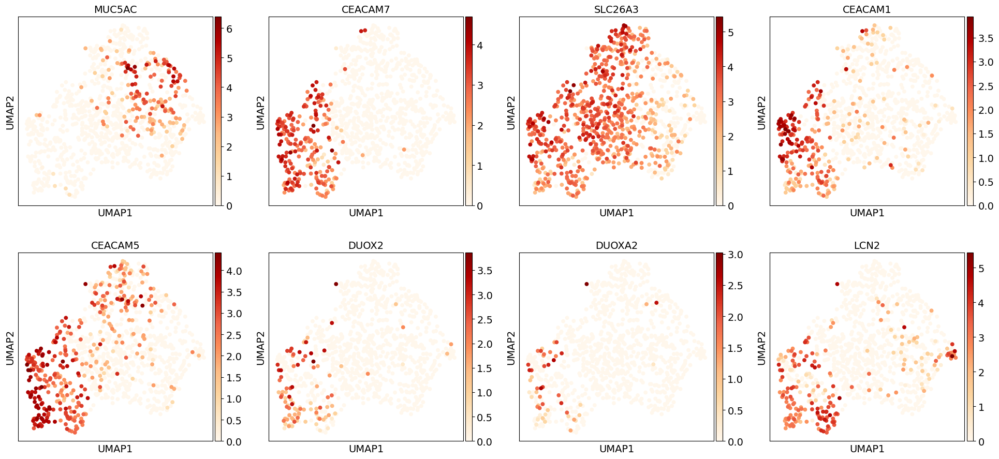

In [28]:
#Some marker/relevant genes with heterogeneity between healthy surface foveolar cells (MUC5AC+) and surface foveolar-like cells
#Extended data 6b
sc.pl.umap(muc5ac,color=['MUC5AC','CEACAM7','SLC26A3','CEACAM1','CEACAM5','DUOX2','DUOXA2','LCN2',], cmap='OrRd',save='muc5ac_marker_umap.pdf')

In [29]:
#leiden cluster and test between clusters
sc.tl.leiden(muc5ac,resolution=0.1)

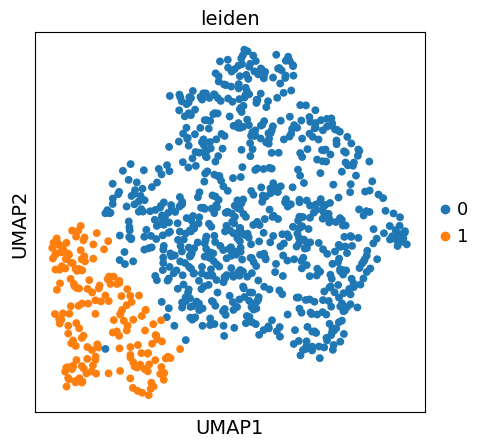

In [30]:
#roughly separate into disease and healthy
sc.pl.umap(muc5ac,color='leiden')

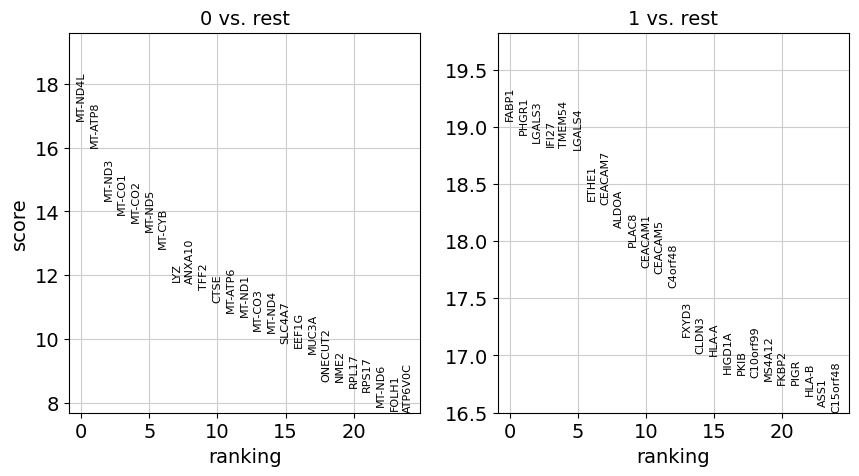

In [31]:
#compare DGE with wilcoxon
muc5ac.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(muc5ac, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(muc5ac, n_genes=25, sharey=False)

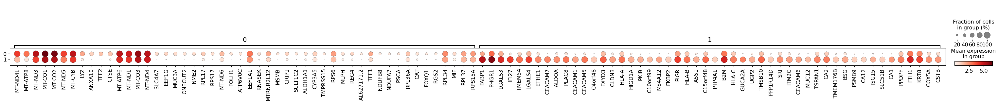

In [32]:
sc.pl.rank_genes_groups_dotplot(muc5ac,n_genes=50)

In [33]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc5ac, group='1',log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

4099


In [34]:
glist

['FABP1',
 'PHGR1',
 'LGALS3',
 'IFI27',
 'TMEM54',
 'LGALS4',
 'ETHE1',
 'CEACAM7',
 'ALDOA',
 'PLAC8',
 'CEACAM1',
 'CEACAM5',
 'C4orf48',
 'FXYD3',
 'CLDN3',
 'HLA-A',
 'HIGD1A',
 'PKIB',
 'C10orf99',
 'MS4A12',
 'FKBP2',
 'PIGR',
 'HLA-B',
 'ASS1',
 'C15orf48',
 'PTP4A1',
 'B2M',
 'HLA-C',
 'GUCA2A',
 'UGP2',
 'TMSB10',
 'PPP1R14D',
 'SRI',
 'ITM2C',
 'CEACAM6',
 'MUC12',
 'TSPAN1',
 'CA2',
 'TMEM176B',
 'BSG',
 'PSMB9',
 'CA12',
 'ISG15',
 'SLC51B',
 'CA1',
 'PPDPF',
 'FTH1',
 'KRT8',
 'COX5A',
 'CSTB',
 'SH3BGRL3',
 'FCGBP',
 'SMIM22',
 'COX5B',
 'S100A10',
 'HK2',
 'SLC26A2',
 'ACTB',
 'DHRS9',
 'CAMK2N1',
 'HLA-E',
 'PAPSS2',
 'KRT18',
 'CA4',
 'SELENBP1',
 'GPA33',
 'OAS1',
 'LYPD8',
 'MGST1',
 'FAM3D',
 'ATP1B3',
 'MISP',
 'U2AF1',
 'TNFSF10',
 'MYL12B',
 'PARM1',
 'ISG20',
 'COX7A2',
 'KRT20',
 'AK1',
 'UQCRQ',
 'HINT1',
 'LCN2',
 'IFITM3',
 'S100A6',
 'NT5C3A',
 'UGT2B17',
 'C2orf88',
 'MRPL23',
 'DDT',
 'COX8A',
 'RHOC',
 'PLS1',
 'MZT2B',
 'ARPC3',
 'GLRX',
 'CLDN7',
 'PR

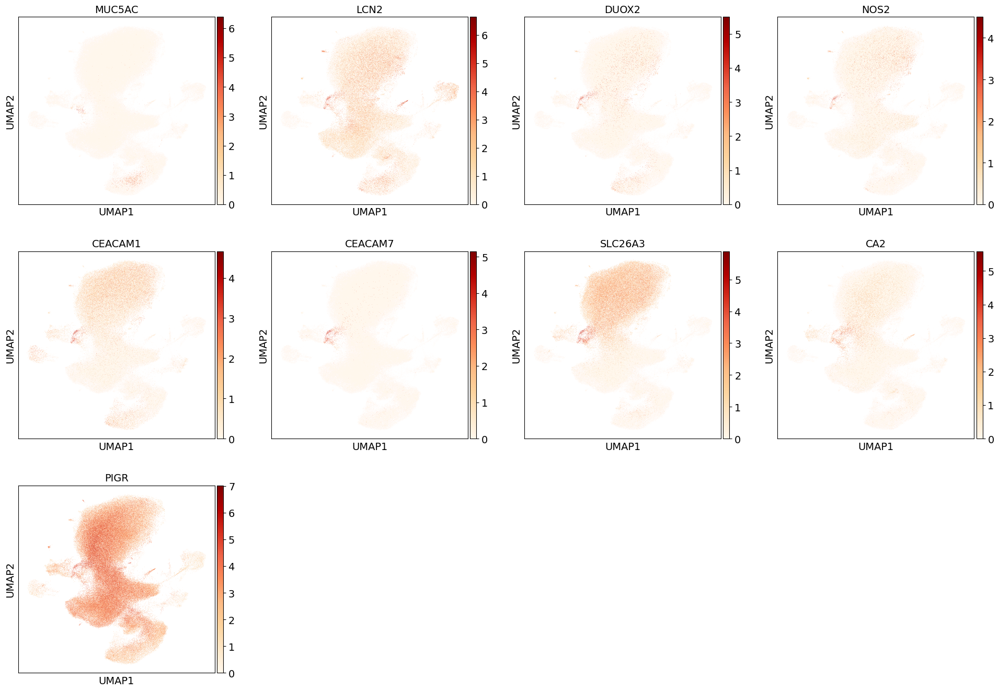

In [35]:
#look at marker/relevant genes across all small intestine epithelial cells
sc.pl.umap(adata,color=['MUC5AC','LCN2','DUOX2','NOS2','CEACAM1',
'CEACAM7','SLC26A3','CA2','PIGR'],cmap='OrRd')

In [36]:
muc5ac.obs['disease'].cat.reorder_categories(['control',

 'crohns_disease',
 'pediatric_IBD',                               
  'neighbouring_inflammed',
                                              'neighbouring_polyps','neighbouring_cancer',
                                            'celiac_active','celiac_treated'
   ], inplace=True)


/home/jovyan/my-conda-envs/standard_plot_gsea/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


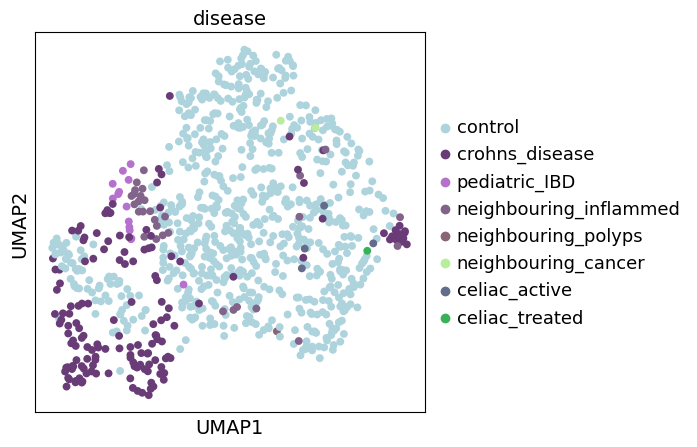

In [37]:
sc.pl.umap(muc5ac,color='disease')

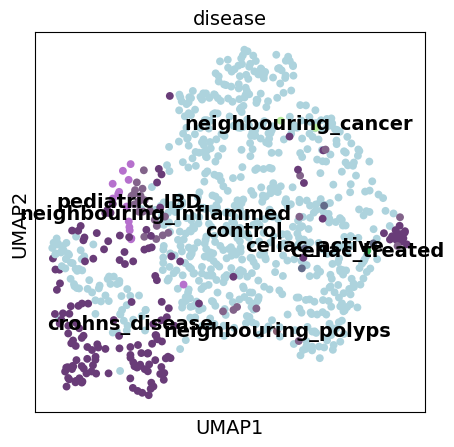

In [38]:
sc.pl.umap(muc5ac,color='disease',legend_loc='on data')

In [39]:
muc5ac

AnnData object with n_obs × n_vars = 941 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_splic

In [40]:
#simplify disease categories for comparison
muc5ac.obs['disease_simplified'] = (muc5ac.obs["disease"].map(lambda x: {
 'control':'healthy',
 'neighbouring_inflammed':'neighbouring',
    'neighbouring_cancer':'neighbouring',
    'neighbouring_polyps':'neighbouring',
 'pediatric_IBD':'IBD',
 'crohns_disease':'IBD',
 'celiac_active':'celiac',
    'celiac_treated':'celiac'#only 1 cell
        
         }.get(x, x)).astype("category"))

In [41]:
muc5ac.obs['disease'].value_counts()

control                   732
crohns_disease            157
neighbouring_inflammed     30
pediatric_IBD              14
celiac_active               4
neighbouring_cancer         2
neighbouring_polyps         1
celiac_treated              1
Name: disease, dtype: int64

In [42]:
muc5ac.obs['disease'].value_counts()

control                   732
crohns_disease            157
neighbouring_inflammed     30
pediatric_IBD              14
celiac_active               4
neighbouring_cancer         2
neighbouring_polyps         1
celiac_treated              1
Name: disease, dtype: int64

In [43]:
muc5ac.uns['log1p']["base"] = None

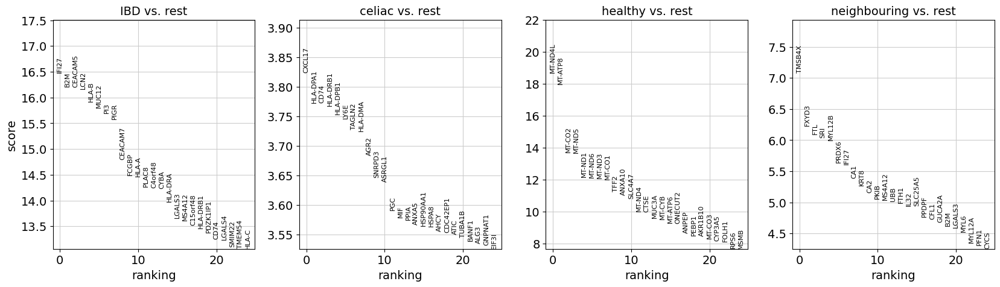

In [44]:
sc.tl.rank_genes_groups(muc5ac,groupby='disease_simplified',method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc5ac, n_genes=25, sharey=False, key="wilcoxon")

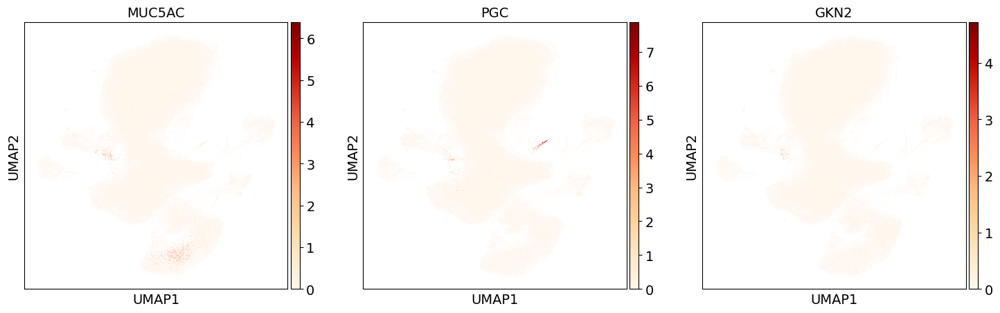

In [45]:
sc.pl.umap(adata,color=['MUC5AC','PGC','GKN2'],cmap='OrRd')

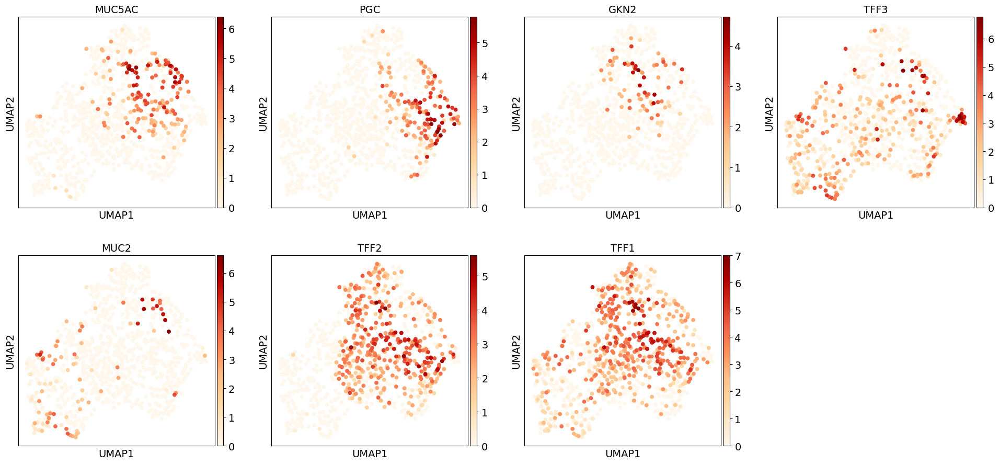

In [46]:
sc.pl.umap(muc5ac,color=['MUC5AC','PGC','GKN2','TFF3','MUC2','TFF2','TFF1'],cmap='OrRd')

#### Distinguish Surface foveolar cells from goblet and enterocyte subsets in small intestine 

In [47]:
muc5_goblet = adata[adata.obs.level_3_annot.isin(['Goblet','Goblet_cycling','Goblet_progenitor','Surface_foveolar'])].copy()

In [48]:
sc.pp.neighbors(muc5_goblet, use_rep="X_scANVI")
sc.tl.umap(muc5_goblet)

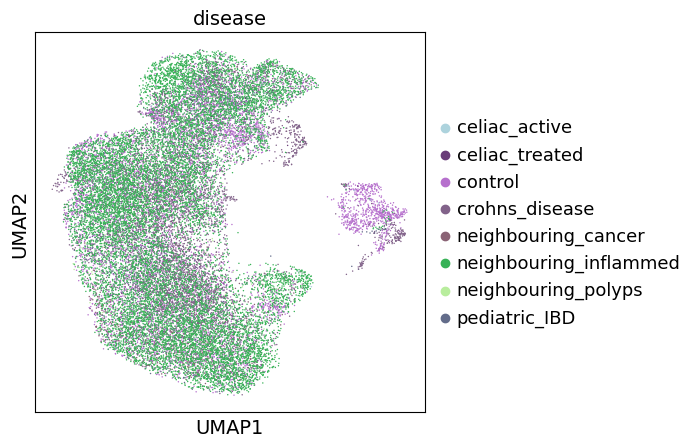

In [49]:
sc.pl.umap(muc5_goblet,color='disease')

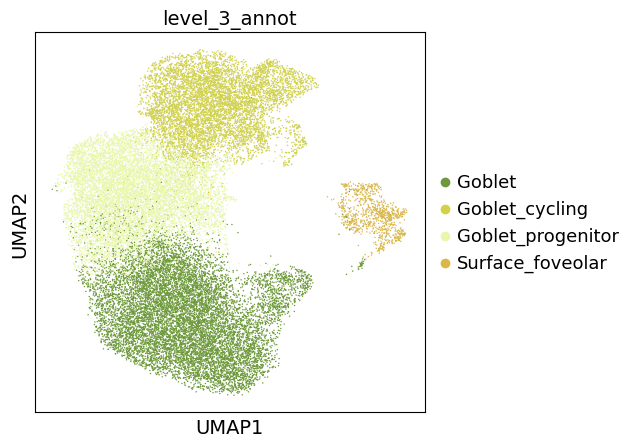

In [50]:
sc.pl.umap(muc5_goblet,color='level_3_annot')

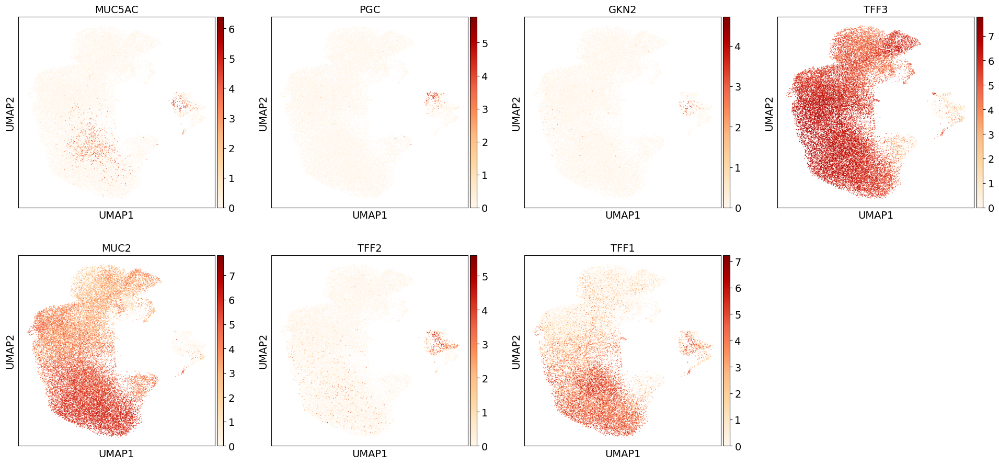

In [51]:
sc.pl.umap(muc5_goblet,color=['MUC5AC','PGC','GKN2','TFF3','MUC2','TFF2','TFF1'],cmap='OrRd')

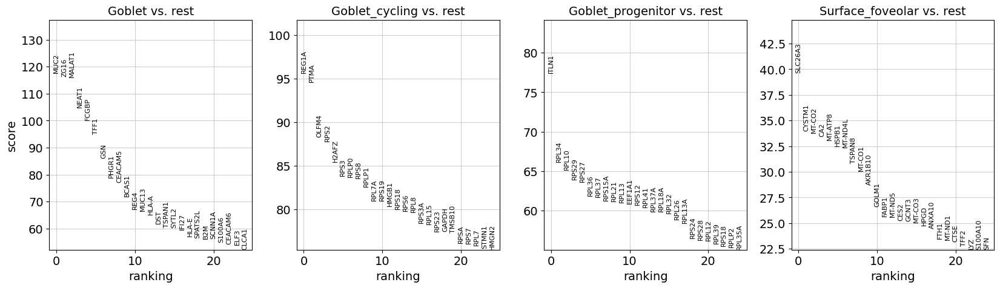

In [52]:
#DGE marker genes distinguishing SF from goblet clusters
muc5_goblet.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(muc5_goblet,groupby='level_3_annot',method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc5_goblet, n_genes=25, sharey=False, key="wilcoxon")

In [53]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

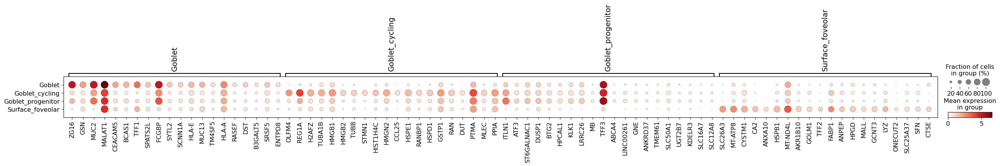

In [54]:
muc5_goblet.raw = muc5_goblet.copy()
mkst = calc_marker_stats(muc5_goblet, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc5_goblet, groupby='level_3_annot', mks=mks,n_genes=20)

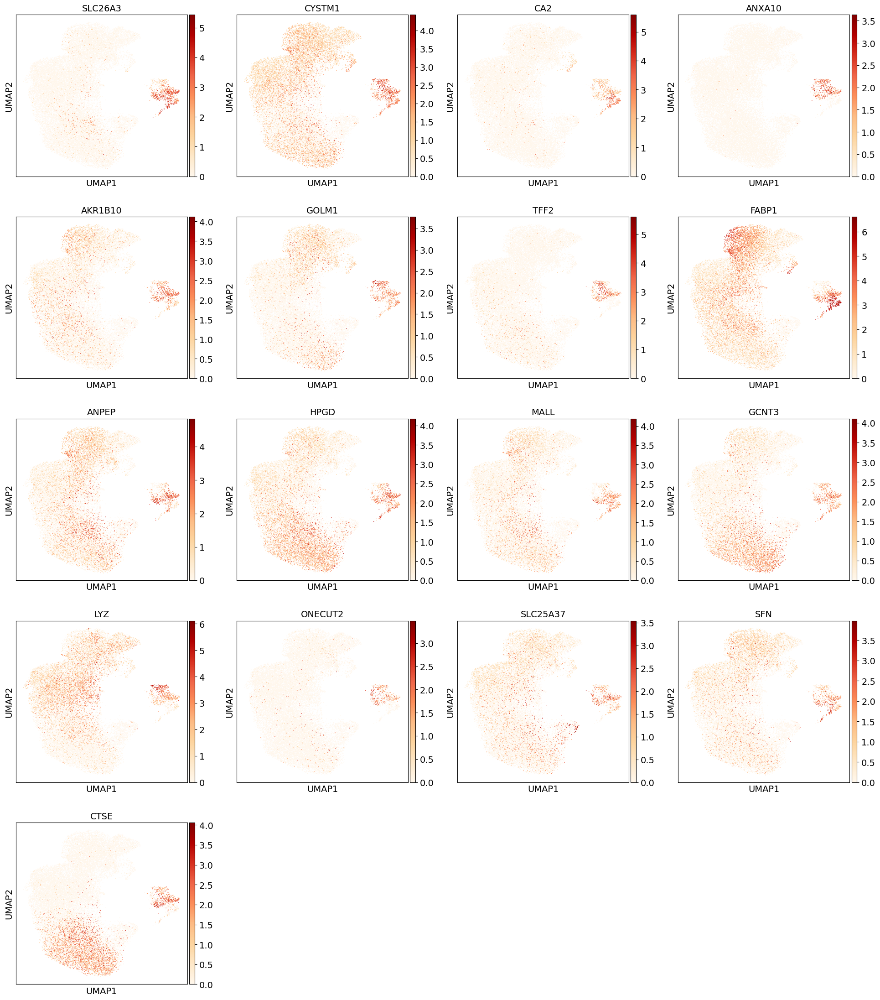

In [55]:
sc.pl.umap(muc5_goblet,color=['SLC26A3','CYSTM1','CA2','ANXA10','AKR1B10','GOLM1','TFF2','FABP1','ANPEP','HPGD','MALL','GCNT3','LYZ','ONECUT2','SLC25A37','SFN','CTSE'],cmap='OrRd')

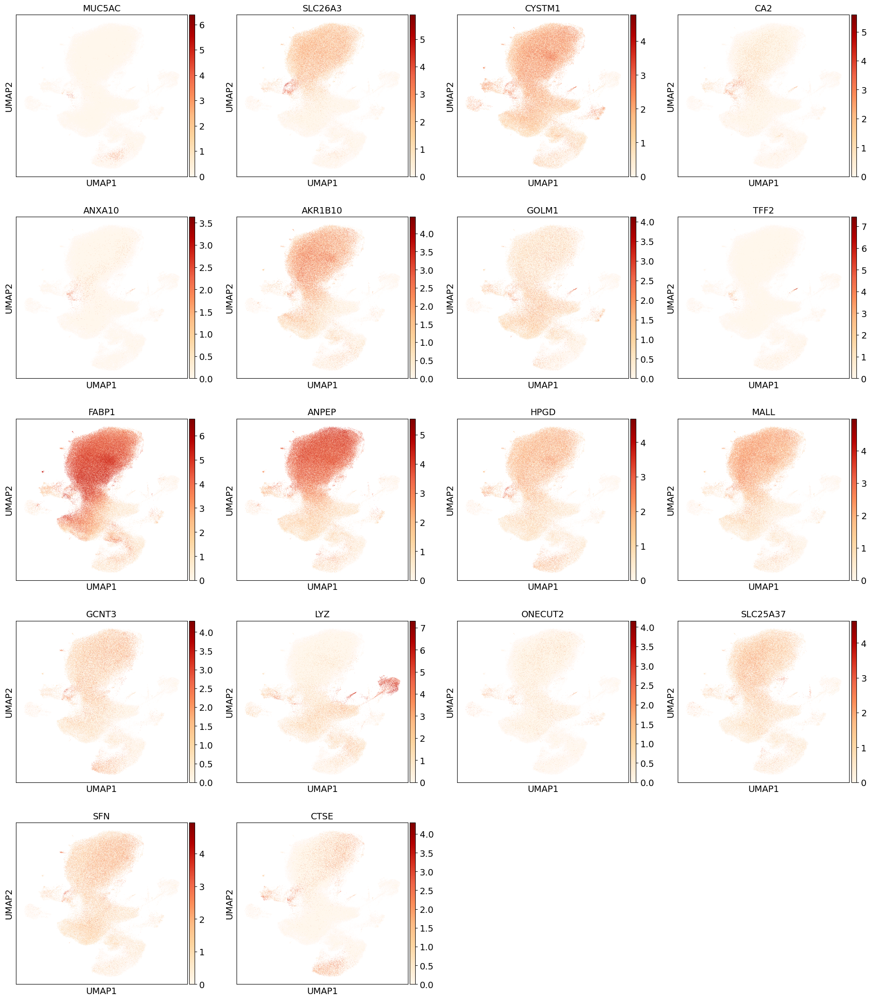

In [56]:
sc.pl.umap(adata,color=['MUC5AC','SLC26A3','CYSTM1','CA2','ANXA10','AKR1B10','GOLM1','TFF2','FABP1','ANPEP','HPGD','MALL','GCNT3','LYZ','ONECUT2','SLC25A37','SFN','CTSE'],cmap='OrRd')

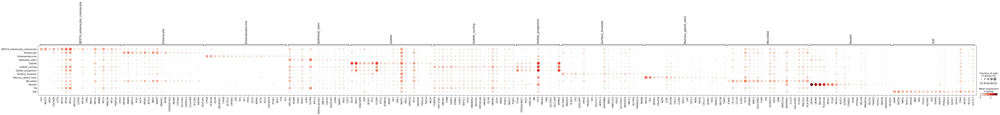

In [57]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='level_3_annot', mks=mks,n_genes=20)

### DGE and GSEA on surface foveolar cells in IBD vs healthy controls

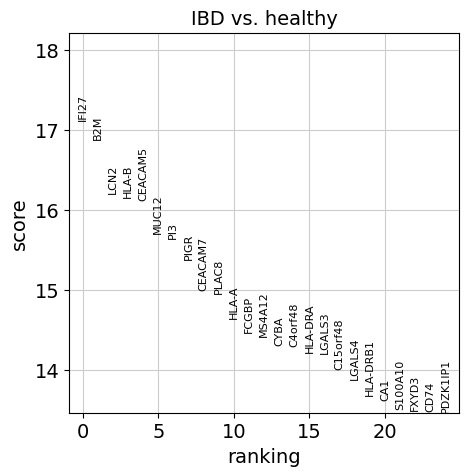

In [59]:
sc.tl.rank_genes_groups(muc5ac,groupby='disease_simplified',groups=['IBD'], reference='healthy', method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc5ac, n_genes=25, sharey=False, key="wilcoxon")

In [60]:
#?gseapy.enrichr
glist = sc.get.rank_genes_groups_df(muc5ac, group='IBD', 
                                    key='wilcoxon', log2fc_min=0.25, 
                                    pval_cutoff=0.05)['names'].squeeze().str.strip().tolist()
print(len(glist))

2709


In [61]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Biological_Process_2018',
                     cutoff = 0.5)

In [62]:
enr_res.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2018,neutrophil degranulation (GO:0043312),183/479,1.308671e-42,5.868081e-39,0,0,4.159558,401.145967,CDA;CYFIP1;ATP8A1;TMEM179B;APEH;SRP14;PYCARD;L...
1,GO_Biological_Process_2018,neutrophil mediated immunity (GO:0002446),184/487,4.793296e-42,7.641336e-39,0,0,4.085602,388.709719,CDA;CYFIP1;ATP8A1;TMEM179B;APEH;SRP14;PYCARD;L...
2,GO_Biological_Process_2018,neutrophil activation involved in immune respo...,183/483,5.112401e-42,7.641336e-39,0,0,4.103131,390.113036,CDA;CYFIP1;ATP8A1;TMEM179B;APEH;SRP14;PYCARD;L...
3,GO_Biological_Process_2018,antigen processing and presentation of exogeno...,43/75,6.172085e-19,6.918907e-16,0,0,8.699093,364.744956,PSMD12;PSMD11;ITGB5;PSMD14;PSMD13;SNAP23;PSMA7...
4,GO_Biological_Process_2018,antigen processing and presentation of exogeno...,43/78,4.718247e-18,4.231324e-15,0,0,7.952074,317.248731,PSMD12;PSMD11;ITGB5;PSMD14;PSMD13;SNAP23;PSMA7...


<AxesSubplot:title={'center':'GO_Biological_Process_2018'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

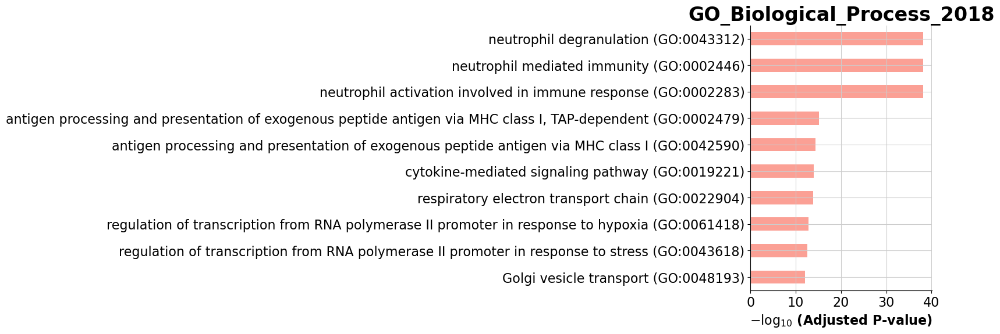

In [63]:
gseapy.barplot(enr_res.res2d,title='GO_Biological_Process_2018')

<AxesSubplot:title={'center':'KEGG_2019_Human'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

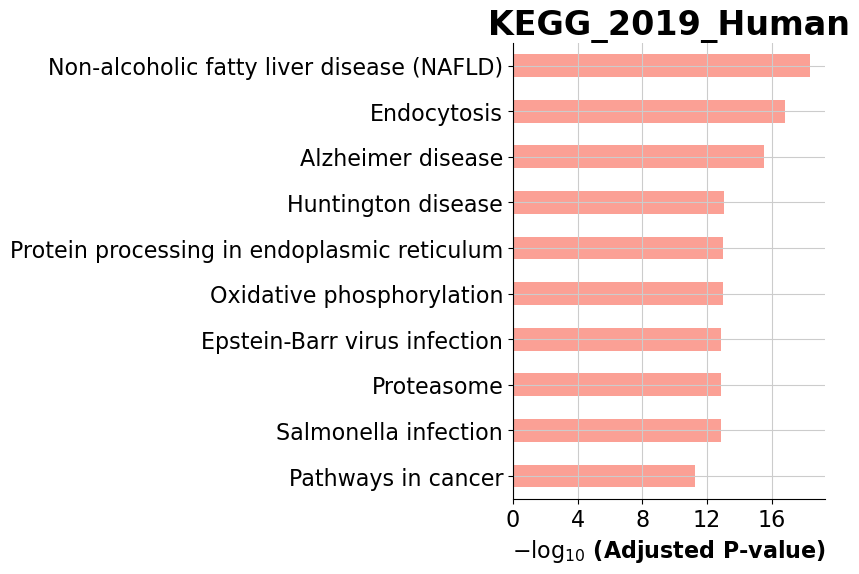

In [64]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='KEGG_2019_Human',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='KEGG_2019_Human')

<AxesSubplot:title={'center':'WikiPathways_2019_Human'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

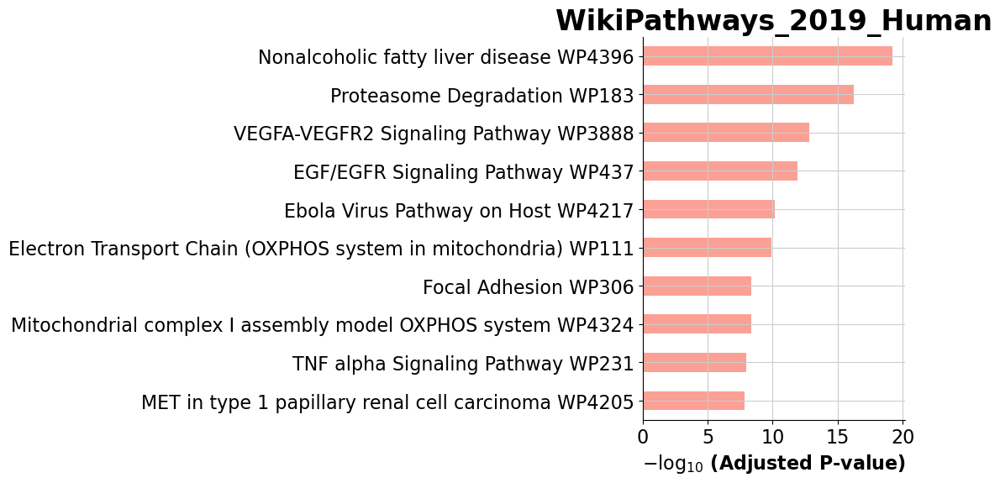

In [65]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='WikiPathways_2019_Human',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='WikiPathways_2019_Human')

<AxesSubplot:title={'center':'GO_Cellular_Component_2021'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

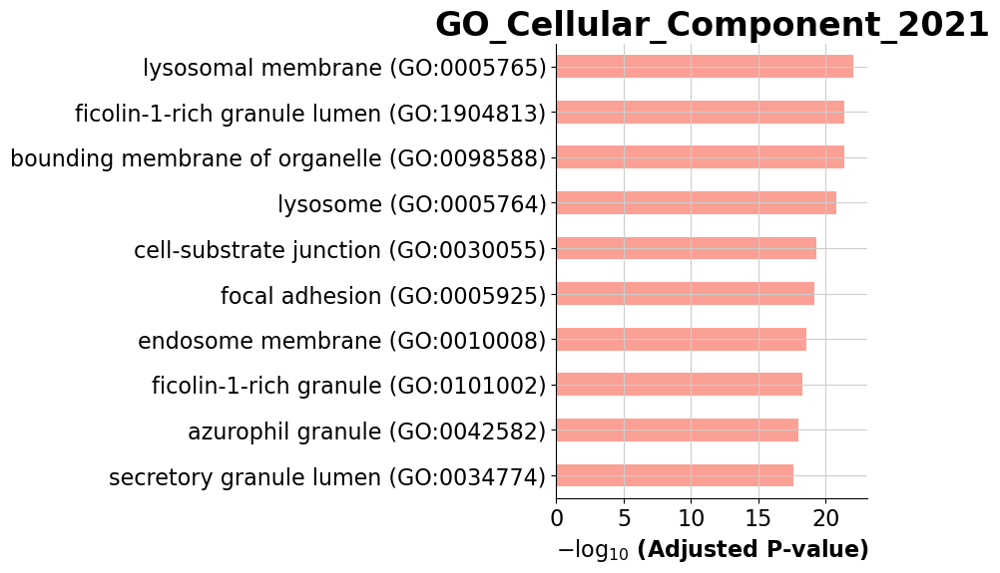

In [66]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Cellular_Component_2021',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='GO_Cellular_Component_2021')

<AxesSubplot:title={'center':'HDSigDB_Human_2021'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

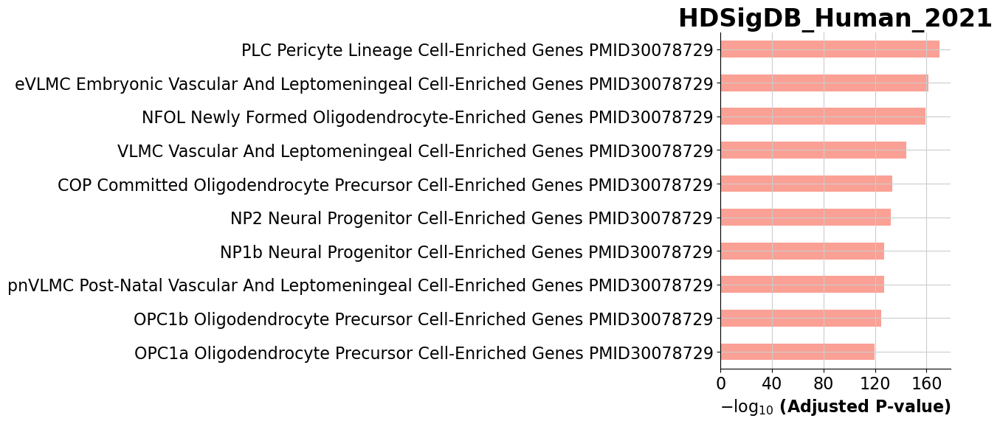

In [67]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='HDSigDB_Human_2021',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='HDSigDB_Human_2021')

<AxesSubplot:title={'center':'MSigDB_Hallmark_2020'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

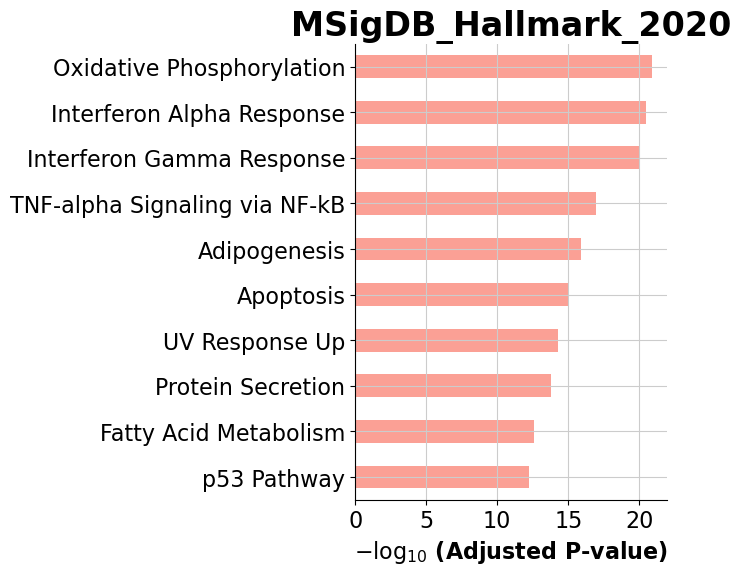

In [68]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='MSigDB_Hallmark_2020',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='MSigDB_Hallmark_2020')

<AxesSubplot:title={'center':'GO_Molecular_Function_2018'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

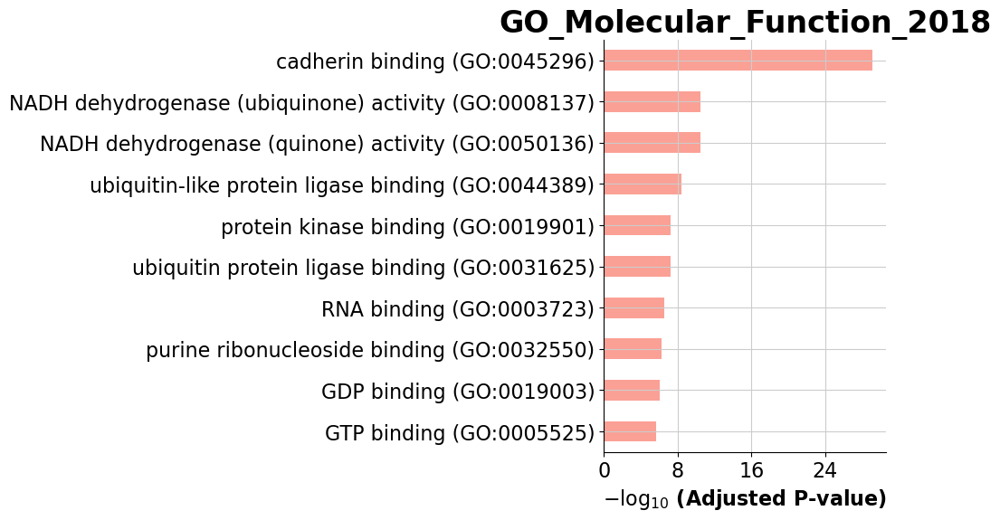

In [69]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Molecular_Function_2018',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='GO_Molecular_Function_2018')

<AxesSubplot:title={'center':'KEGG_2021_Human'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

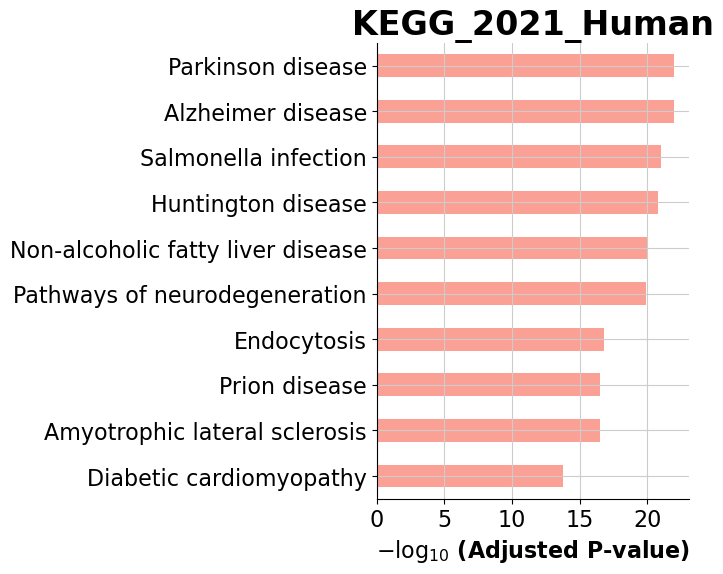

In [70]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='KEGG_2021_Human',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='KEGG_2021_Human')

<AxesSubplot:title={'center':'RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

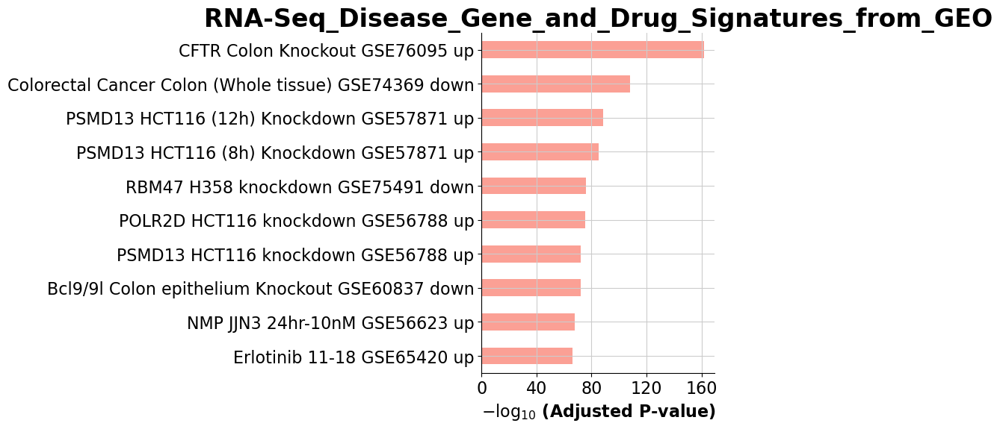

In [71]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='RNA-Seq_Disease_Gene_and_Drug_Signatures_from_GEO')

<AxesSubplot:title={'center':'Reactome_2016'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

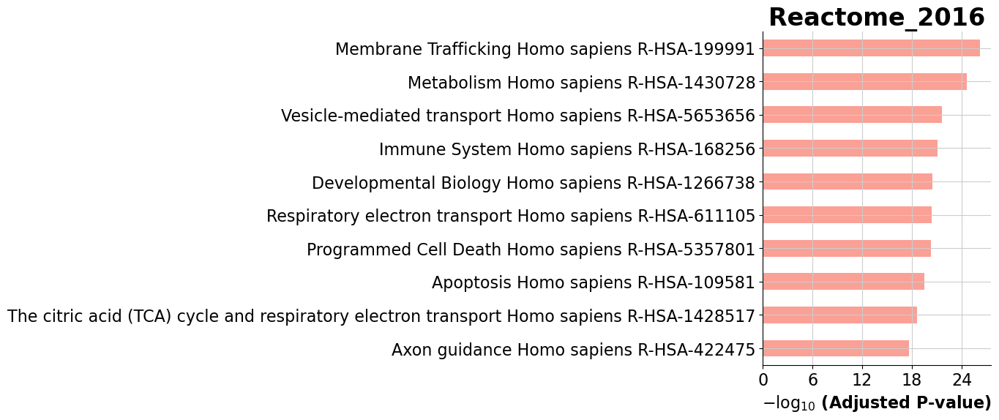

In [72]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='Reactome_2016',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='Reactome_2016')

<AxesSubplot:title={'center':'Reactome_2022'}, xlabel='$- \\log_{10}$ (Adjusted P-value)'>

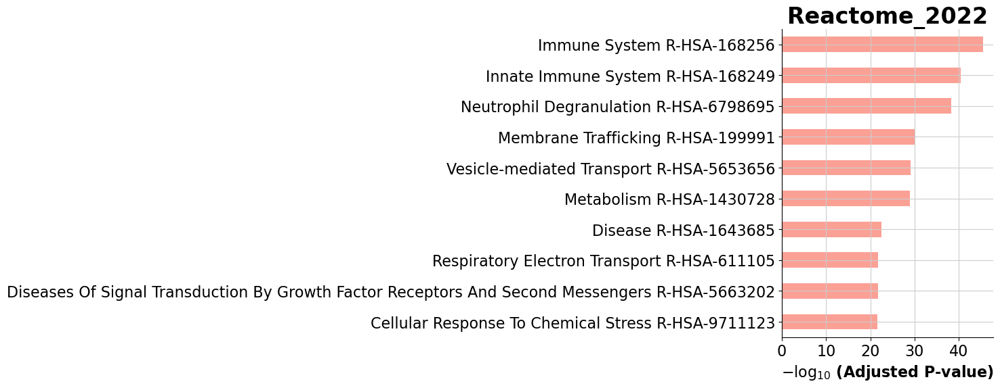

In [73]:
enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='Reactome_2022',
                     cutoff = 0.5)
gseapy.barplot(enr_res.res2d,title='Reactome_2022',topterm=15)

In [74]:
from gseapy import barplot, dotplot

In [75]:
enr_res.results.head()

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,Reactome_2022,Immune System R-HSA-168256,493/1943,1.854791e-49,3.056696e-46,0,0,2.430478,272.721294,CDA;CYFIP1;WIPF2;C4BPB;PSMD8;PSMD7;PSMD4;AKT2;...
1,Reactome_2022,Innate Immune System R-HSA-168249,307/1035,3.842021e-44,3.165826e-41,0,0,2.907857,290.691875,CDA;CYFIP1;WIPF2;UBE2L6;C4BPB;PSMD8;LGALS3;RPS...
2,Reactome_2022,Neutrophil Degranulation R-HSA-6798695,179/468,9.107296e-42,5.002942e-39,0,0,4.162312,393.336438,CDA;CYFIP1;ATP8A1;TMEM179B;APEH;SRP14;PYCARD;L...
3,Reactome_2022,Membrane Trafficking R-HSA-199991,194/599,1.877962e-33,7.737204e-31,0,0,3.216144,242.352929,ITSN2;SCOC;KDELR1;GCC2;GOLGA2;TFG;AKT2;FTH1;AP...
4,Reactome_2022,Vesicle-mediated Transport R-HSA-5653656,200/637,2.161602e-32,7.124641e-30,0,0,3.074333,224.155368,ITSN2;SCOC;KDELR1;GCC2;GOLGA2;TFG;AKT2;FTH1;AP...


In [76]:
# run enrichr
# if you are only intrested in dataframe that enrichr returned, please set outdir=None
enr = gseapy.enrichr(gene_list=glist, # or "./tests/data/gene_list.txt", 
                 gene_sets=['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2018'], 
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk 
                )

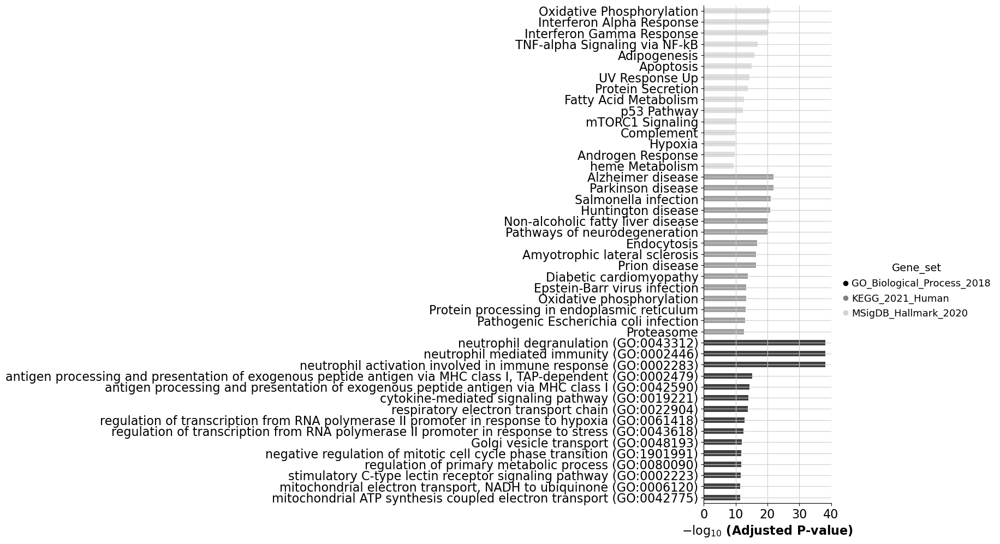

In [78]:
# categorical scatterplot
ax = barplot(enr.results, 
              column="Adjusted P-value", 
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=10, 
              top_term=15,
              figsize=(3,12), 
              color=['black', 'grey', 'lightgrey'] # set colors for group
             )
ax.figure.savefig('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/Surface_foveolar_analysis/figures/SF_IBD_vs_healthy_genesets.pdf', bbox_inches='tight')

In [79]:
#plot other mucins in surface foveolar cells
#mucin gene list - https://www.genenames.org/data/genegroup/#!/group/648
mucin = ['MUC1','MUC2','MUC3A','MUC4','MUC5AC','MUC5B',
         'MUC6','MUC7','MUC12','MUC13','EMCN',
         'MUC15','MUC16','MUC17','MUC19','MUC20','MUC21',#'MUC22','OGVP1','MUC3B','MUC8',
        ]
#glycosytransferase gene list - https://www.genenames.org/data/genegroup/#!/group/424
gt = ['ALG10','B3GAT','COLGALT','EXT','FUT','GCNT','XYLT','PYG',
      'POGLUT','MGAT','GALNT','STT3','UGGT','UGT']

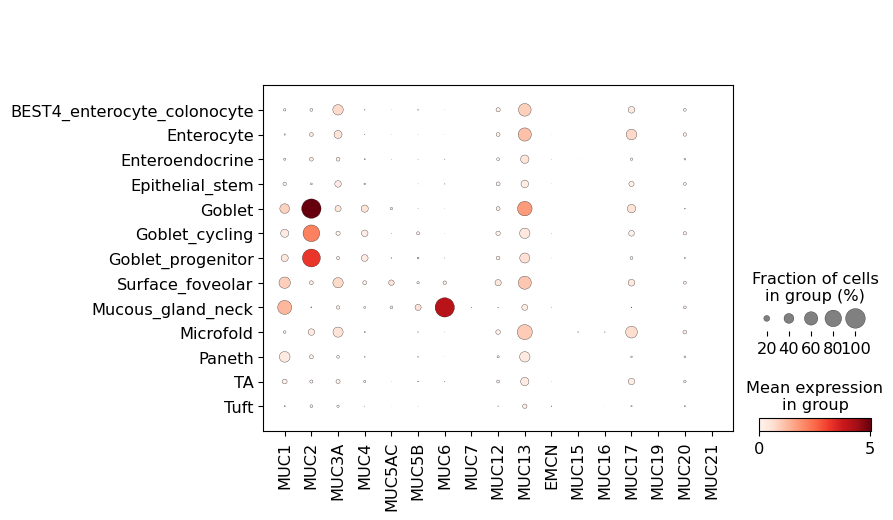

In [80]:
sc.pl.dotplot(adata,var_names = mucin,groupby='level_3_annot')

In [81]:
adata.obs['disease_simplified'] = (adata.obs["disease"].map(lambda x: {
 'control':'healthy',
 'neighbouring_inflammed':'neighbouring',
    'neighbouring_cancer':'neighbouring',
    'neighbouring_polyps':'neighbouring',
 'pediatric_IBD':'IBD',
 'crohns_disease':'IBD',
 'celiac_active':'celiac',
    'celiac_treated':'celiac'#only 1 cell
        
         }.get(x, x)).astype("category"))

In [82]:
IBD = adata[adata.obs.disease_simplified.isin(['IBD'])].copy()

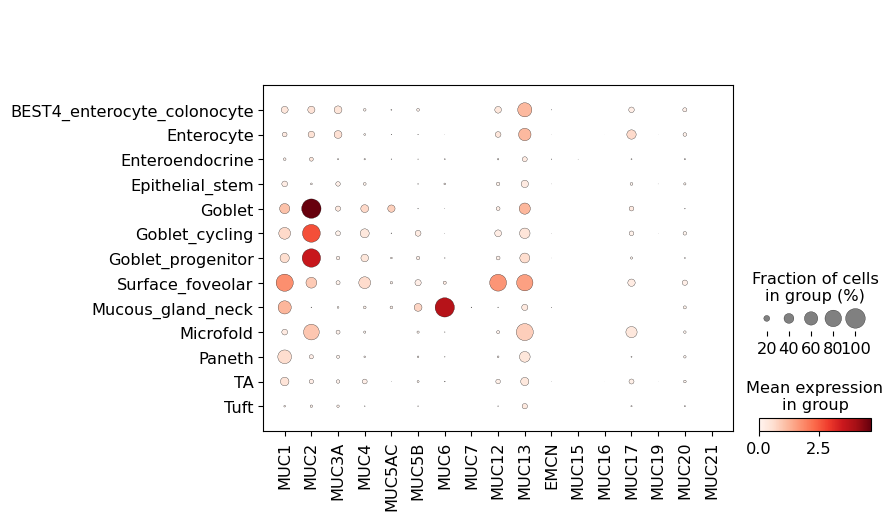

In [83]:
sc.pl.dotplot(IBD,var_names = mucin,groupby='level_3_annot')

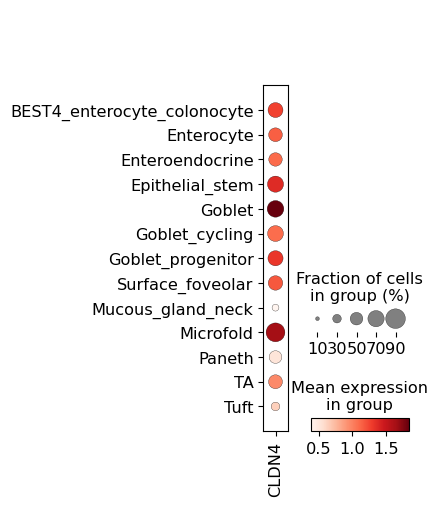

In [84]:
sc.pl.dotplot(adata,var_names = 'CLDN4',groupby='level_3_annot')

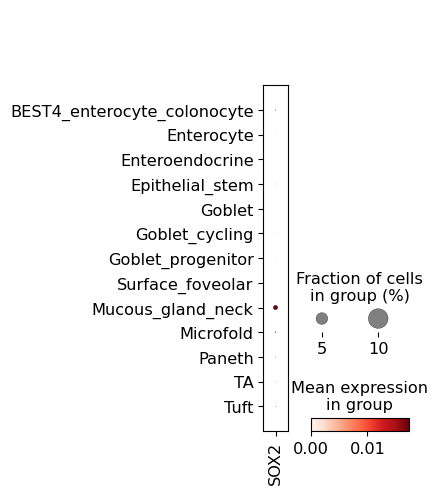

In [85]:
sc.pl.dotplot(adata,var_names = ['SOX2'],groupby='level_3_annot')

In [86]:
control = adata[adata.obs.disease_simplified.isin(['healthy'])].copy()

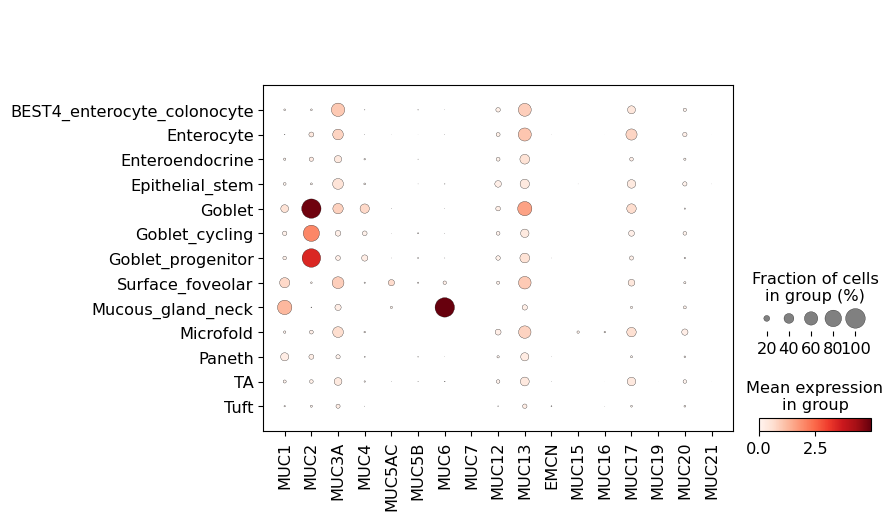

In [87]:
sc.pl.dotplot(control,var_names = mucin,groupby='level_3_annot')

In [88]:
muc5ac

AnnData object with n_obs × n_vars = 941 × 18485
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_splic

In [89]:
#label donors by disease
muc5ac.obs['donor_disease'] = muc5ac.obs['disease'].astype(str)+'_'+muc5ac.obs['donorID_unified'].astype(str)

In [90]:
muc5ac.obs['donor_disease'].value_counts()

control_D11                    574
control_D202                    69
crohns_disease_D220             63
control_D13                     62
crohns_disease_D185             47
neighbouring_inflammed_D39      23
crohns_disease_D191             18
crohns_disease_D179             15
pediatric_IBD_D153              14
crohns_disease_D43              10
control_D99                      8
control_D3                       8
control_D12                      3
control_D158                     3
neighbouring_inflammed_D141      2
celiac_active_D164               2
neighbouring_inflammed_D191      2
crohns_disease_D186              2
celiac_active_D161               2
neighbouring_cancer_D35          2
crohns_disease_D48               1
neighbouring_inflammed_D42       1
neighbouring_inflammed_D48       1
control_D216                     1
neighbouring_polyps_D2           1
control_D4                       1
crohns_disease_D42               1
control_D28                      1
control_D157        

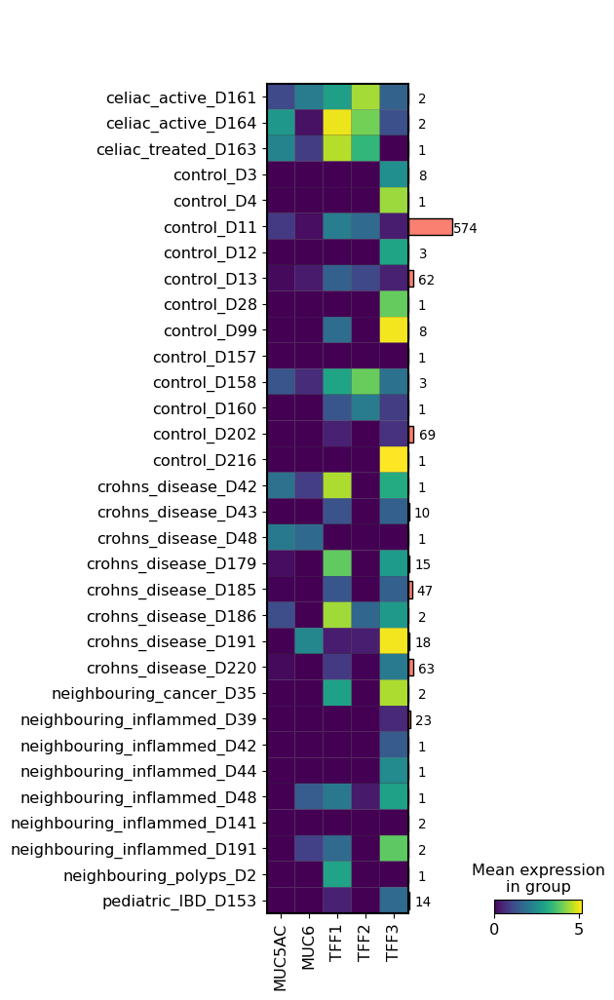

In [91]:
#plot marker genes per donor/disease
mp = sc.pl.matrixplot(muc5ac, var_names=['MUC5AC','MUC6','TFF1','TFF2','TFF3'], groupby='donor_disease', return_fig=True)
mp.add_totals().style(edge_color='black').show()

### Subclustering of SF cells, INFLAREs/MGN cells and goblet or enterocytes
- to distinguish that SF cells are distinct from goblet or enterocyte subsets
- also distinct from MGN/INFLAREs but more transcriptionally similar

In [92]:
muc5_gm6 = adata[adata.obs.level_3_annot.isin(['Goblet','Goblet_cycling','Goblet_progenitor','Surface_foveolar','Mucous_gland_neck'])].copy()

In [93]:
sc.pp.neighbors(muc5_gm6, use_rep="X_scANVI")
sc.tl.umap(muc5_gm6)

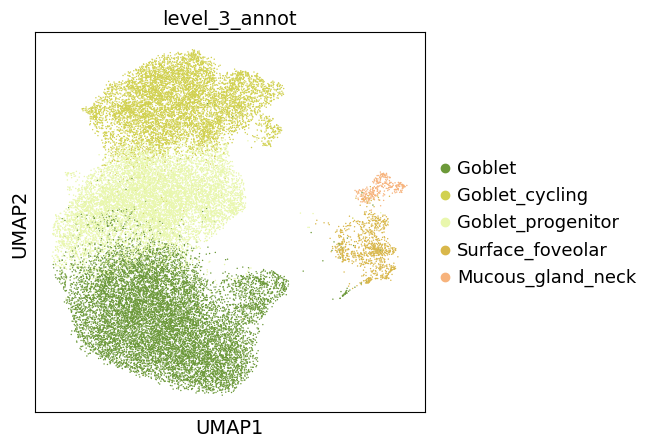

In [94]:
sc.pl.umap(muc5_gm6,color='level_3_annot')

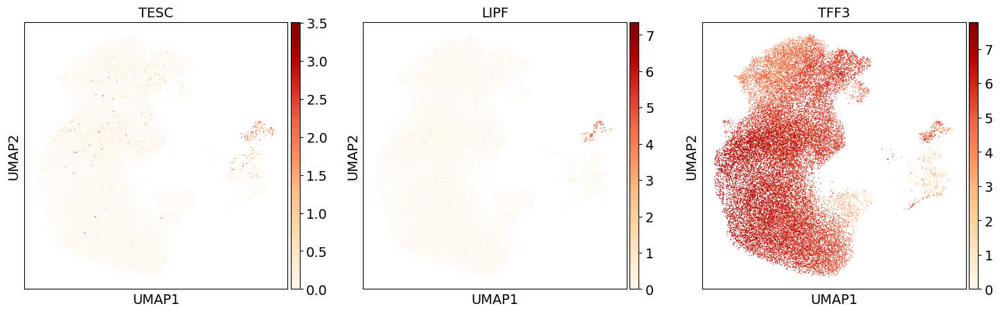

In [95]:
sc.pl.umap(muc5_gm6,color=['TESC', 'LIPF', 'TFF3'],cmap='OrRd')

In [96]:
muc5_entero = adata[adata.obs.level_3_annot.isin(['Enterocyte','Surface_foveolar','BEST4_enterocyte_colonocyte'])].copy()

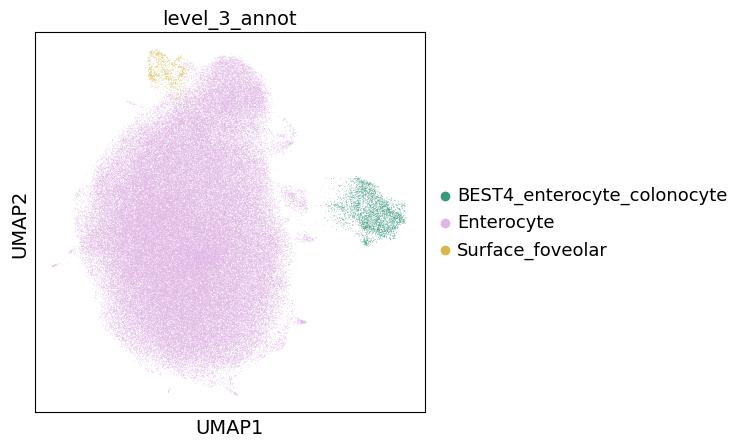

In [98]:
sc.pp.neighbors(muc5_entero, use_rep="X_scANVI")
sc.tl.umap(muc5_entero)
sc.pl.umap(muc5_entero,color='level_3_annot')

In [101]:
muc5_entero_MUC6 = adata[adata.obs.level_3_annot.isin(['Enterocyte','Surface_foveolar','BEST4_enterocyte_colonocyte','Mucous_gland_neck'])].copy()

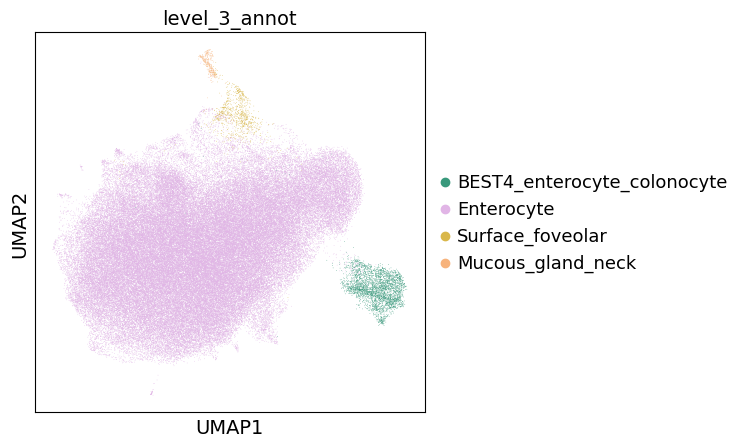

In [102]:
sc.pp.neighbors(muc5_entero_MUC6, use_rep="X_scANVI")
sc.tl.umap(muc5_entero_MUC6)
sc.pl.umap(muc5_entero_MUC6,color='level_3_annot')

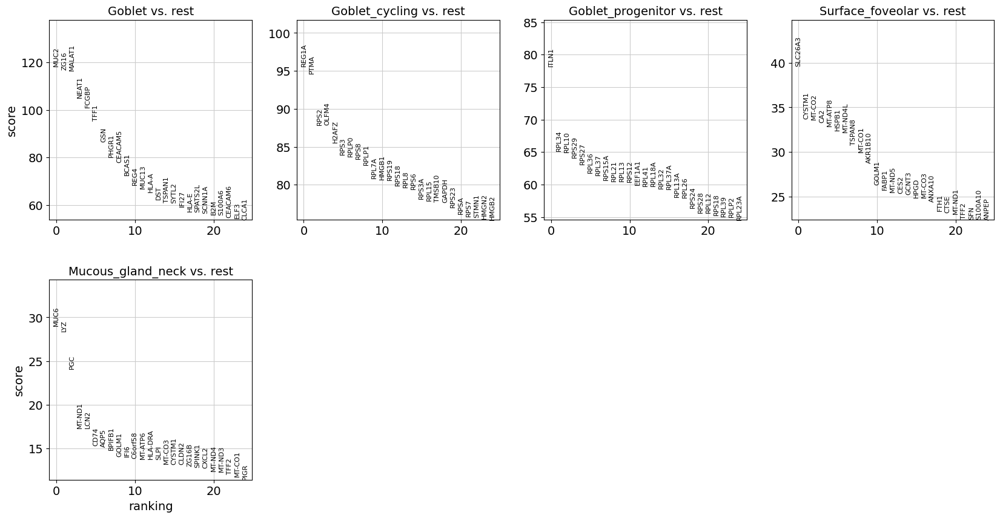

In [104]:
#assess
muc5_gm6.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(muc5_gm6,groupby='level_3_annot',method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc5_gm6, n_genes=25, sharey=False, key="wilcoxon")

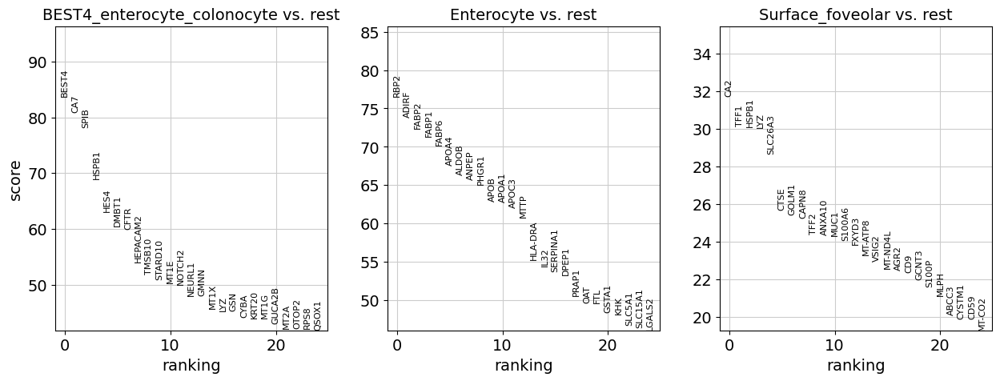

In [105]:
muc5_entero.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(muc5_entero,groupby='level_3_annot',method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc5_entero, n_genes=25, sharey=False, key="wilcoxon")

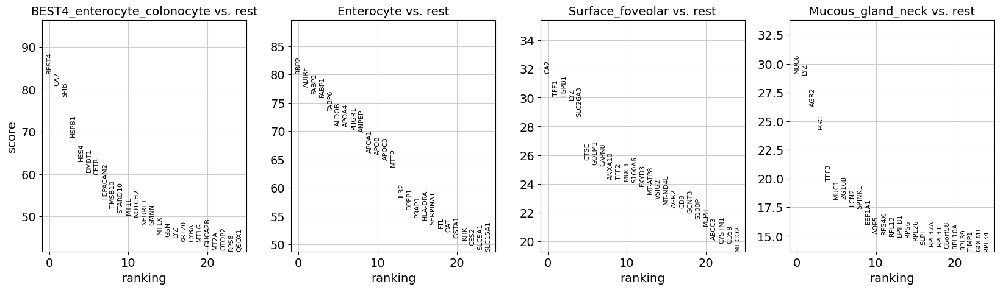

In [106]:
muc5_entero_MUC6.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(muc5_entero_MUC6,groupby='level_3_annot',method='wilcoxon',key_added = "wilcoxon")
sc.pl.rank_genes_groups(muc5_entero_MUC6, n_genes=25, sharey=False, key="wilcoxon")

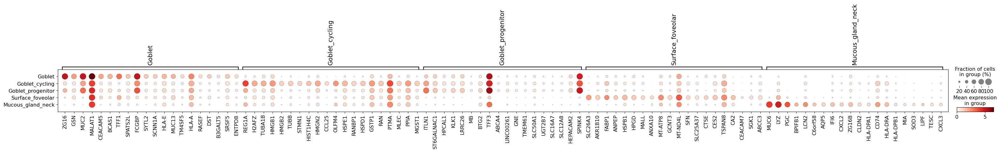

In [107]:
muc5_gm6.raw = muc5_gm6.copy()
mkst = calc_marker_stats(muc5_gm6, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc5_gm6, groupby='level_3_annot', mks=mks,n_genes=20)

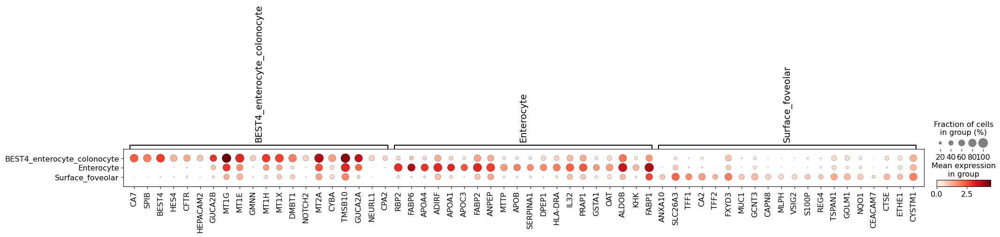

In [108]:
muc5_entero.raw = muc5_entero.copy()
mkst = calc_marker_stats(muc5_entero, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc5_entero, groupby='level_3_annot', mks=mks,n_genes=20)

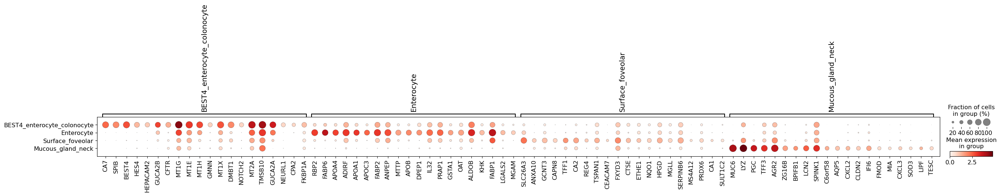

In [109]:
muc5_entero_MUC6.raw = muc5_entero_MUC6.copy()
mkst = calc_marker_stats(muc5_entero_MUC6, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc5_entero_MUC6, groupby='level_3_annot', mks=mks,n_genes=20)

In [110]:
# export figures for revised manuscript

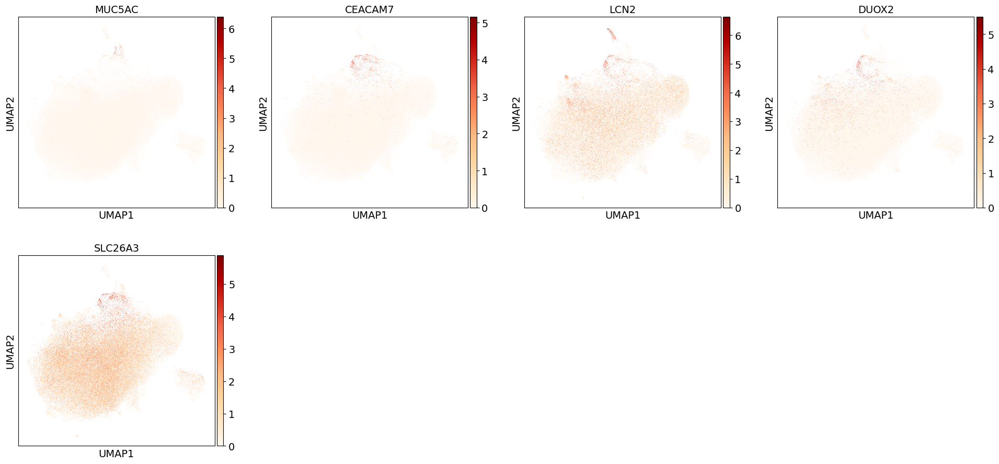

In [112]:
sc.pl.umap(muc5_entero_MUC6,color=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3'],cmap='OrRd')

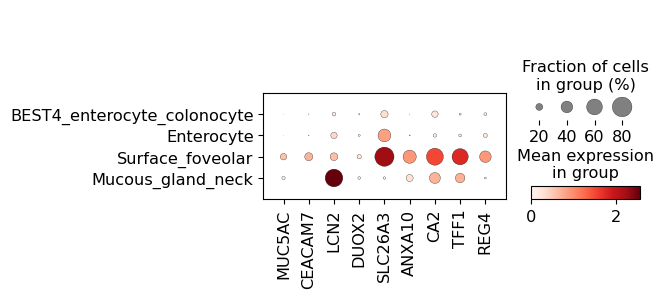

In [114]:
sc.pl.dotplot(muc5_entero_MUC6,var_names=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3','ANXA10','CA2','TFF1','REG4'],groupby='level_3_annot')

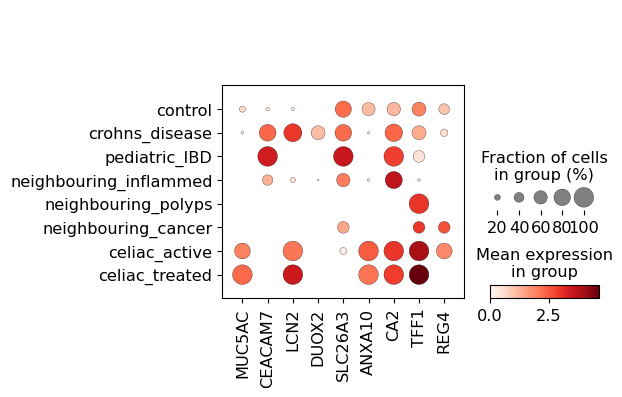

In [116]:
sc.pl.dotplot(muc5ac,var_names=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3','ANXA10','CA2','TFF1','REG4'],groupby='disease')

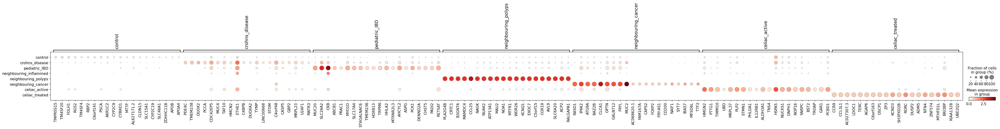

In [117]:
muc5ac.raw = muc5ac.copy()
mkst = calc_marker_stats(muc5ac, groupby="disease")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc5ac, groupby='disease', mks=mks,n_genes=20)

In [118]:
muc5ac.obs['disease_donor'] = muc5ac.obs.disease.astype('str') +'_'+muc5ac.obs.donorID_unified.astype('str')

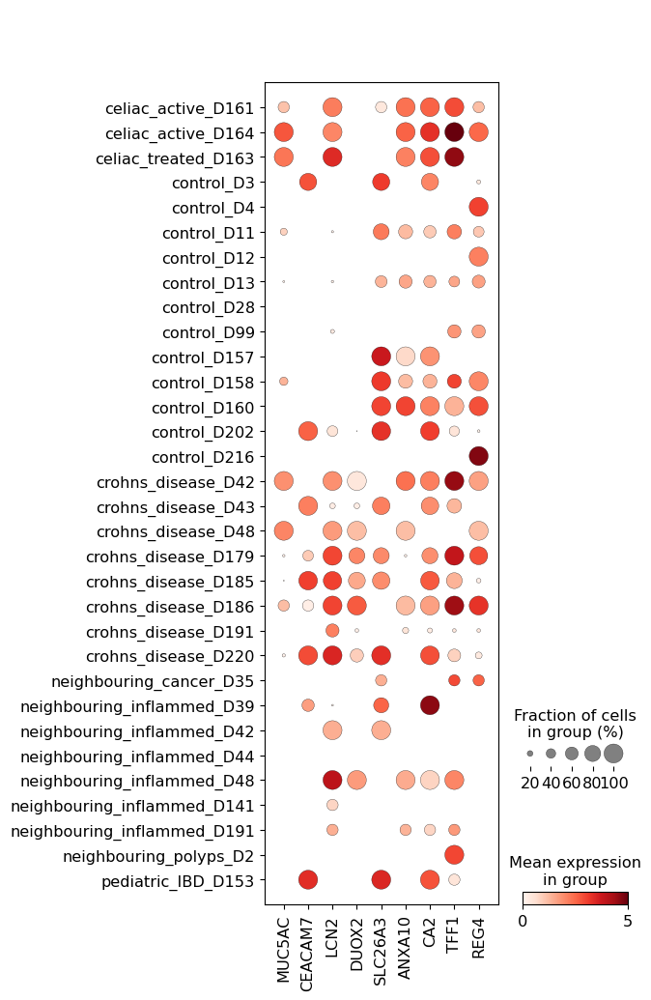

In [119]:
sc.pl.dotplot(muc5ac,var_names=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3','ANXA10','CA2','TFF1','REG4'],groupby='disease_donor')

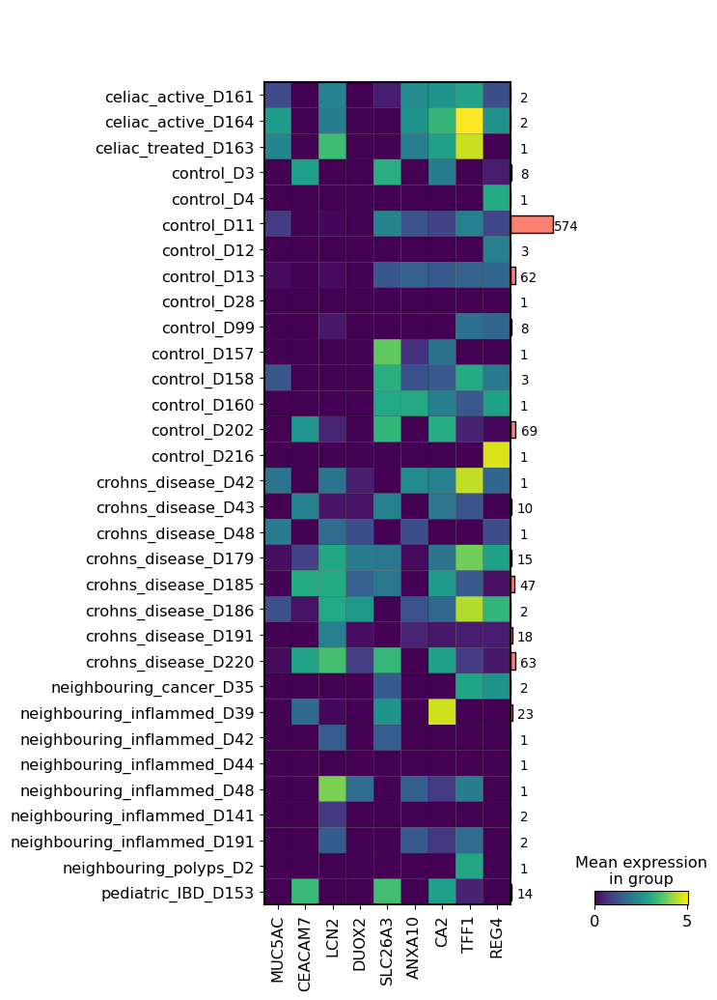

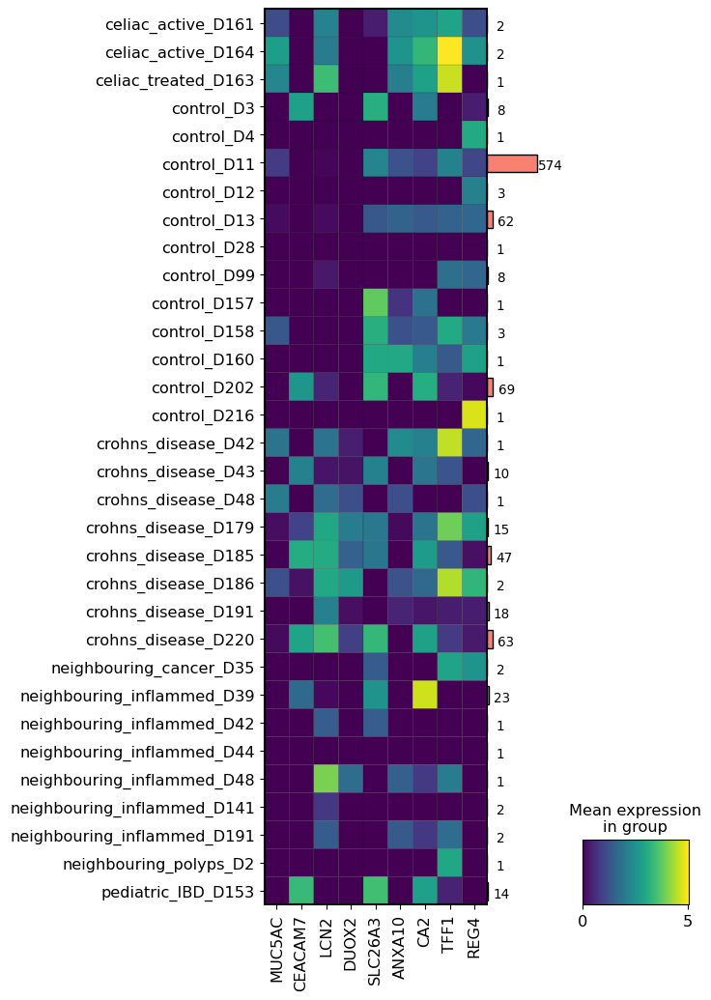

In [127]:
mp = sc.pl.matrixplot(muc5ac,var_names=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3','ANXA10','CA2','TFF1','REG4'],groupby='disease_donor',return_fig=True,cmap='RdBu_r')
mp.add_totals().style(edge_color='black').show()
mp.savefig('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/Surface_foveolar_analysis/figures/donor_disease_SFcells_matrixplotaddtotals.pdf')

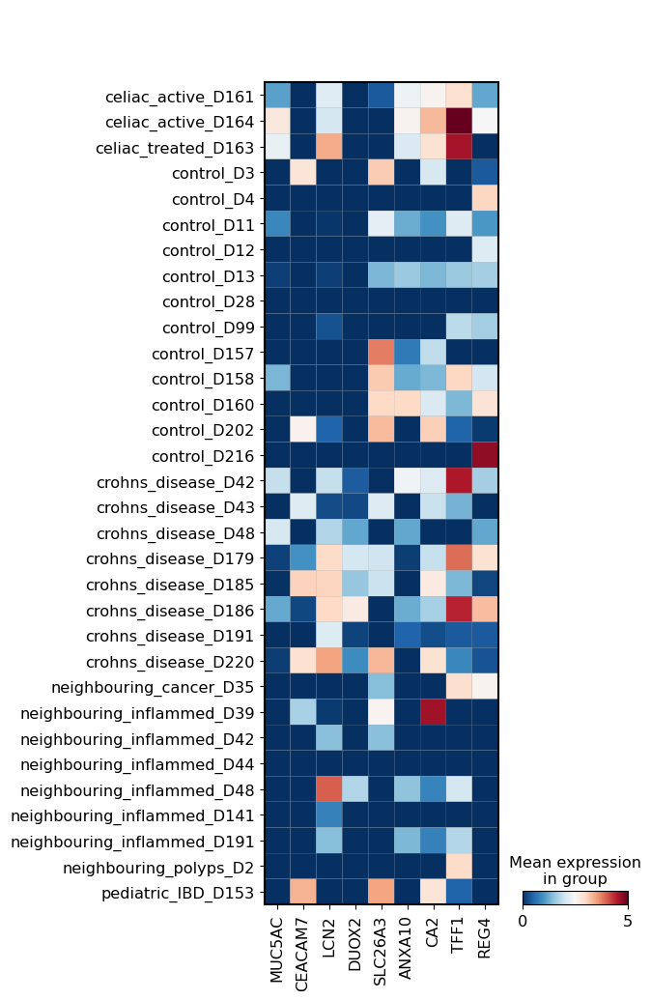

In [126]:
sc.pl.matrixplot(muc5ac,var_names=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3','ANXA10','CA2','TFF1','REG4'],groupby='disease_donor',cmap='RdBu_r',save='donor_disease_SFcells_RdBucmap.pdf')

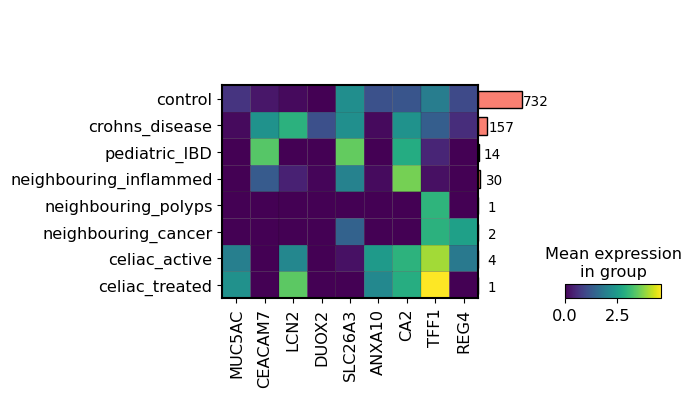

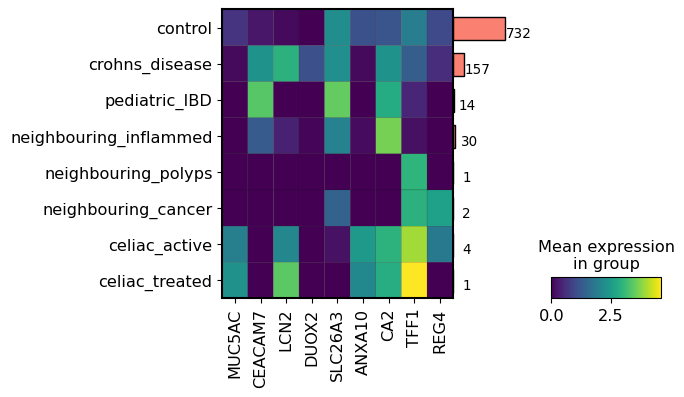

In [128]:
mp = sc.pl.matrixplot(muc5ac,var_names=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3','ANXA10','CA2','TFF1','REG4'],groupby='disease',return_fig=True)
mp.add_totals().style(edge_color='black').show()
mp.savefig('/nfs/team205/ao15/Megagut/Annotations_v3/disease_analysis/Surface_foveolar_analysis/figures/disease_SFcells_matrixplotaddtotals.pdf')

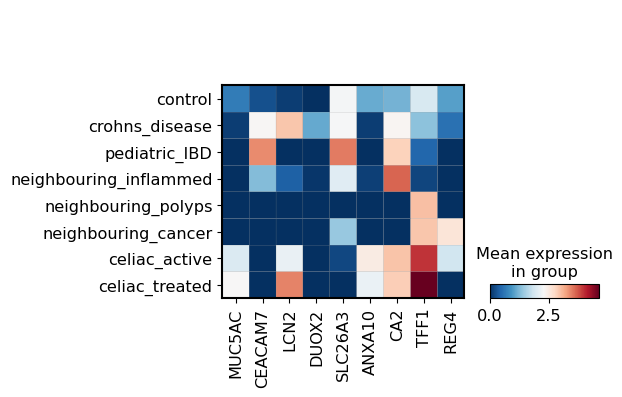

In [130]:
mp = sc.pl.matrixplot(muc5ac,var_names=['MUC5AC','CEACAM7','LCN2','DUOX2','SLC26A3','ANXA10','CA2','TFF1','REG4'],groupby='disease',cmap="RdBu_r",save = 'disease_SFcells_RdBucmap.pdf')

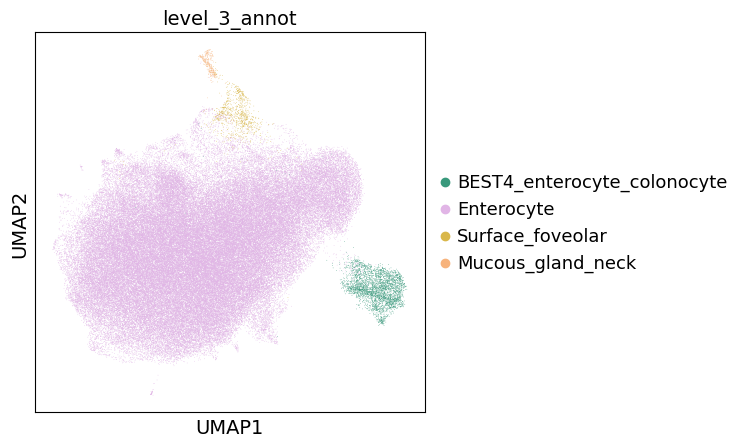

In [131]:
sc.pl.umap(muc5_entero_MUC6,color='level_3_annot',save='SF_entero_muc6_umap.pdf')

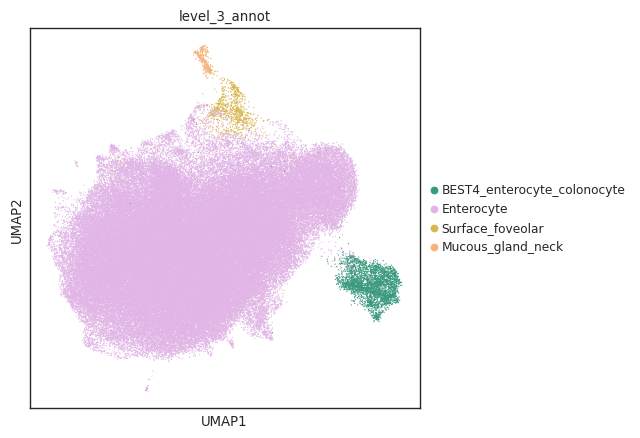

In [202]:
#Extended data 6c
sc.pl.umap(muc5_entero_MUC6,color='level_3_annot',save='SF_entero_muc6_umap.pdf',size=3)

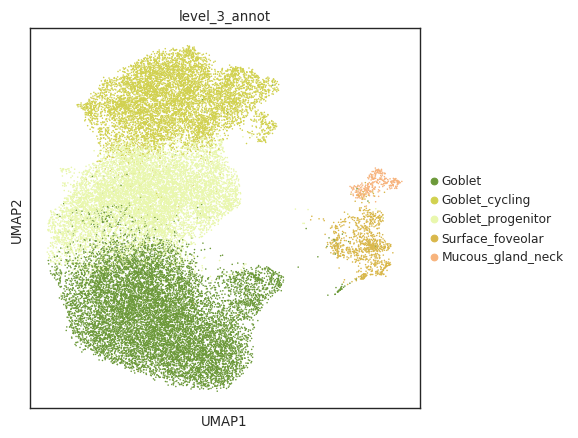

In [204]:
#Extended data 6c
sc.pl.umap(muc5_gm6,color='level_3_annot',save='SF_goblet_muc6_umap.pdf',size=5)

In [133]:
sc.tl.leiden(muc5_entero_MUC6,resolution=1)

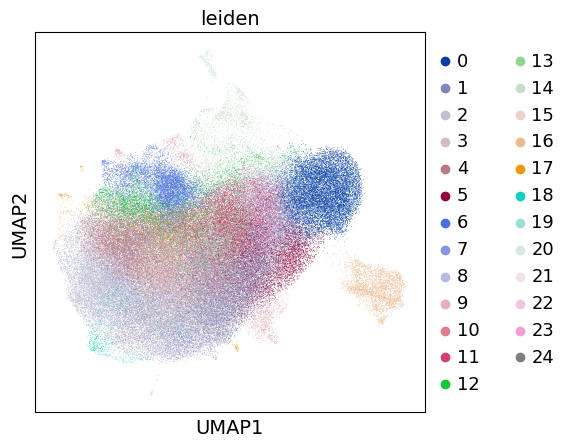

In [135]:
sc.pl.umap(muc5_entero_MUC6,color='leiden')

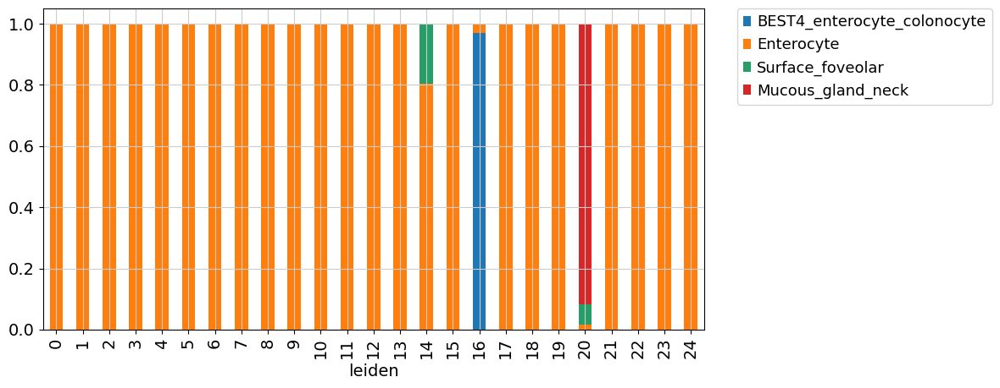

In [136]:
plt.rcParams['figure.figsize'] = [10,5]
tmp = pd.crosstab(muc5_entero_MUC6.obs['leiden'], muc5_entero_MUC6.obs['level_3_annot'],normalize='index')
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

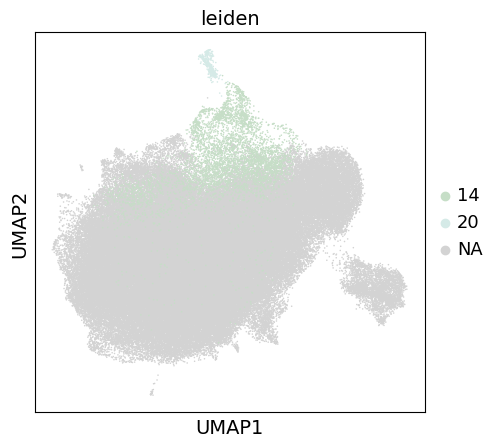

In [141]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(muc5_entero_MUC6,color='leiden',groups=['14','20'],size=5)

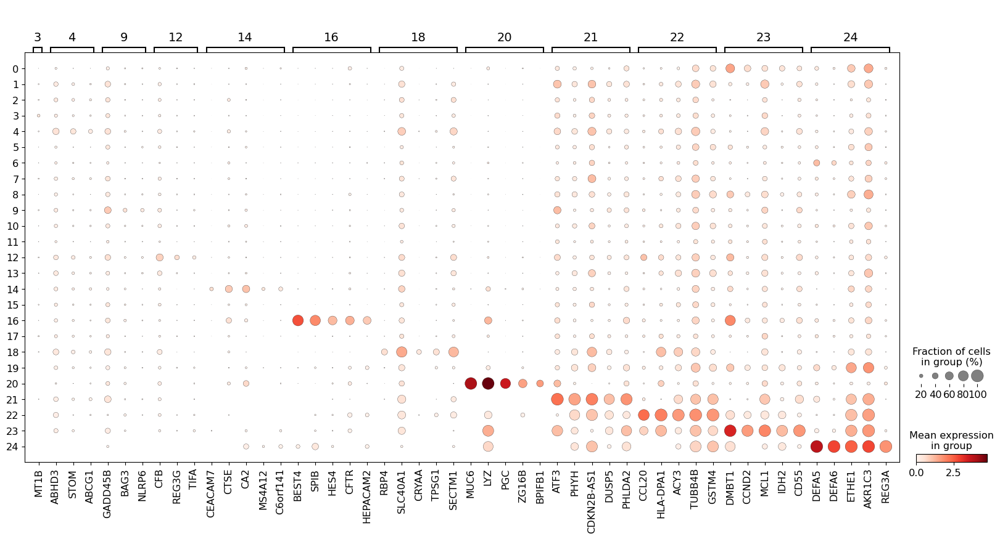

In [142]:
muc5_entero_MUC6.raw = muc5_entero_MUC6.copy()
mkst = calc_marker_stats(muc5_entero_MUC6, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc5_entero_MUC6, groupby='leiden', mks=mks,n_genes=5)

In [143]:
genes_to_plot = ['CEACAM5',
 'IFI27',
 'CEACAM7',
 'CA2',
 'PLAC8',
 'MUC12',
 'SLC26A3',
 'TSPAN1',
 'S100A6',
 'PI3',
 'FXYD3',
 'MS4A12',
 'FABP1',
 'TMEM54',
 'CA1',
 'S100A10',
 'CEACAM6',
 'C15orf48',
 'C19orf33',
 'PHGR1',
 'LGALS3',
 'ETHE1',
 'PIGR',
 'CEACAM1',
 'RHOC',
 'MUC1',
 'LCN2',
 'S100P',
 'UGP2',
 'KRT20',
 'PKIB',
 'ASS1',
 'SMIM22',
 'TSPAN8',
 'ITM2C',
 'B2M',
 'SLPI',
 'SH3BGRL3',
 'CCL28',
 'CTSS',
 'MYL12B',
 'PLS1',
 'CSTB',
 'SULT1B1',
 'HIGD1A',
 'EMP1',
 'LINC01133',
 'GPT',
 'MISP',
 'PLA2G10']

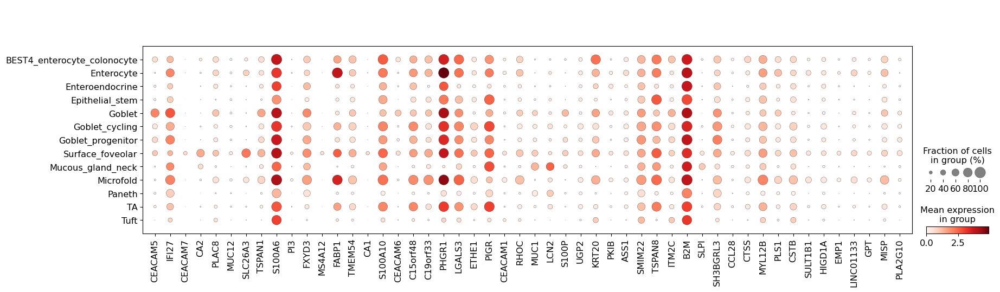

In [144]:
sc.pl.dotplot(adata,var_names=genes_to_plot,groupby='level_3_annot')

In [145]:
sc.tl.score_genes(adata, genes_to_plot, ctrl_size=50, score_name='SFlike_score')

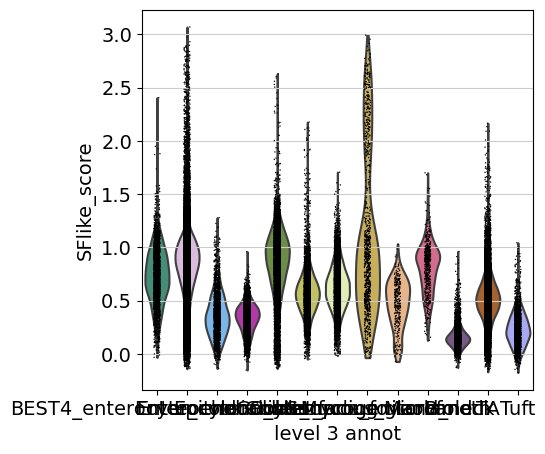

In [148]:
sc.pl.violin(adata,keys='SFlike_score',groupby='level_3_annot')

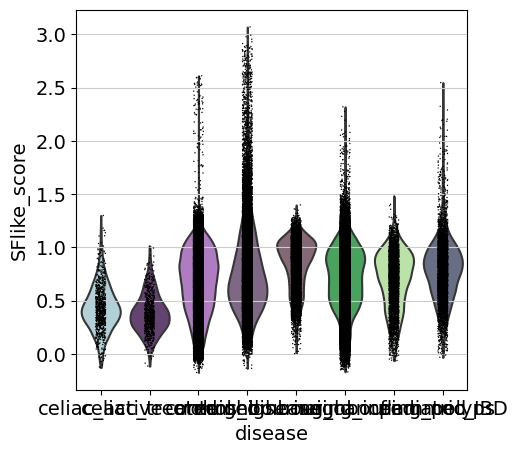

In [149]:
sc.pl.violin(adata,keys='SFlike_score',groupby='disease')

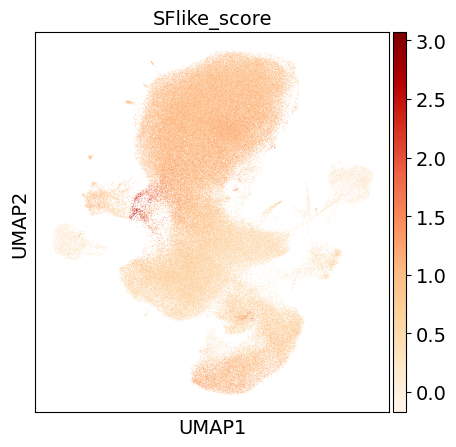

In [150]:
sc.pl.umap(adata,color='SFlike_score',cmap='OrRd')

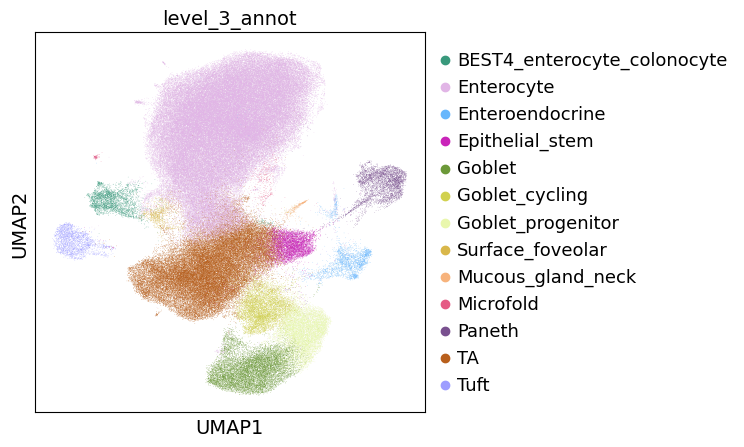

In [151]:
sc.pl.umap(adata,color='level_3_annot')

In [153]:
SF = adata[adata.obs.level_3_annot.isin(['Surface_foveolar'])].copy()

In [154]:
SF.obs['disease_annot'] = SF.obs.disease.astype(str)+'_'+SF.obs.level_3_annot.astype(str)

In [157]:
SF.obs['disease_annot'].value_counts()

control_Surface_foveolar                   732
crohns_disease_Surface_foveolar            157
neighbouring_inflammed_Surface_foveolar     30
pediatric_IBD_Surface_foveolar              14
celiac_active_Surface_foveolar               4
neighbouring_cancer_Surface_foveolar         2
neighbouring_polyps_Surface_foveolar         1
celiac_treated_Surface_foveolar              1
Name: disease_annot, dtype: int64

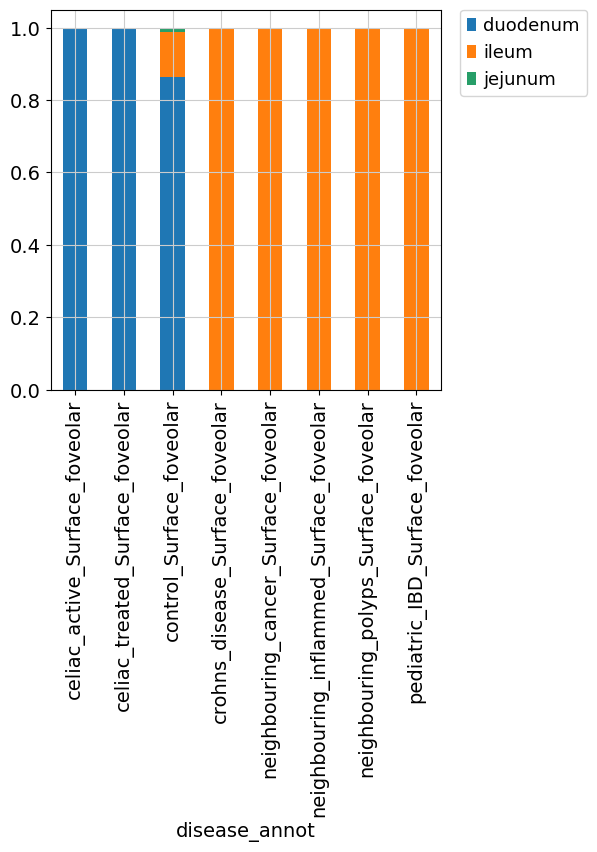

In [158]:
tmp = pd.crosstab(SF.obs['disease_annot'], SF.obs['organ_unified'],normalize='index')
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

In [165]:
SF.obs['disease_organ'] = SF.obs.disease.astype(str)+'_'+SF.obs.organ_unified.astype(str)

In [166]:
SF.obs['disease_organ'].value_counts()

control_duodenum                633
crohns_disease_ileum            157
control_ileum                    91
neighbouring_inflammed_ileum     30
pediatric_IBD_ileum              14
control_jejunum                   8
celiac_active_duodenum            4
neighbouring_cancer_ileum         2
neighbouring_polyps_ileum         1
celiac_treated_duodenum           1
Name: disease_organ, dtype: int64

In [167]:
SF.obs['disease_organ'].unique()

array(['control_ileum', 'neighbouring_polyps_ileum', 'control_duodenum',
       'control_jejunum', 'neighbouring_inflammed_ileum',
       'neighbouring_cancer_ileum', 'pediatric_IBD_ileum',
       'crohns_disease_ileum', 'celiac_active_duodenum',
       'celiac_treated_duodenum'], dtype=object)

In [168]:
SF.obs['level_3_annot_SFplot'] = (
   SF.obs["disease_organ"]
    .map(lambda x: {'control_ileum':'Surface_foveolar (control ileum)'
                    , 'neighbouring_polyps_ileum':'Discard', 'control_duodenum':'Surface_foveolar (control duodenum)',
       'control_jejunum':'Surface_foveolar (control ileum)', 'neighbouring_inflammed_ileum':'Surface_foveolar_like (neighbouring inflamed ileum)',
       'neighbouring_cancer_ileum':'Discard', 'pediatric_IBD_ileum':'Surface_foveolar_like (IBD ileum)',
       'crohns_disease_ileum':'Surface_foveolar_like (IBD ileum)', 'celiac_active_duodenum':'Surface_foveolar (celiac duodenum)',
       'celiac_treated_duodenum':'Discard'
    }.get(x, x))
    .astype("category")
)

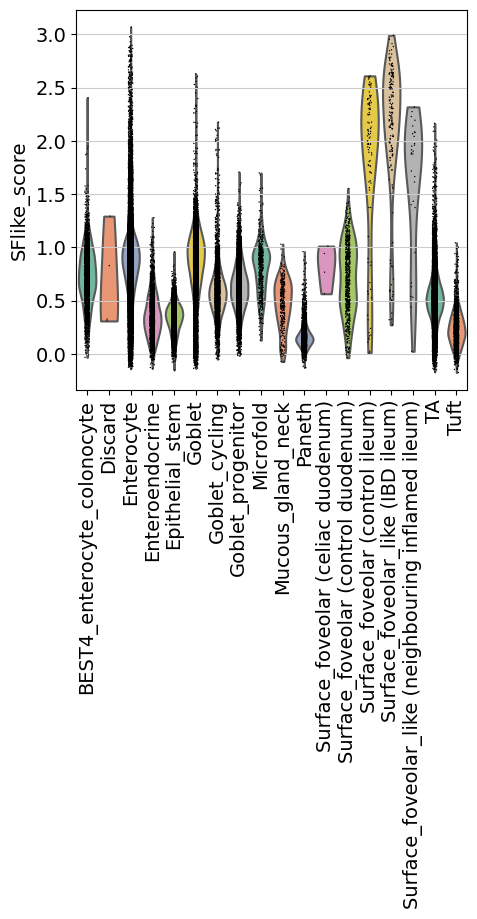

In [169]:
ON = {O:N for O,N in zip(SF.obs_names,SF.obs["level_3_annot_SFplot"])}
adata.obs["level_3_annot_SFplot"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["level_3_annot"])]
sc.pl.violin(adata,keys='SFlike_score',groupby='level_3_annot_SFplot',rotation=90,palette='Set2')

In [170]:
duo_SFgenes = ['MT-ATP8',
 'MT-ND4L',
 'SLC26A3',
 'CTSE',
 'ANXA10',
 'MT-ND6',
 'TFF2',
 'GCNT3',
 'CA2',
 'HPGD',
 'LYZ',
 'TFF1',
 'FOLH1',
 'CAPN8',
 'AKR1B10',
 'ONECUT2',
 'MUC3A',
 'AKR1C2',
 'SULT1C2',
 'MTRNR2L12',
 'TMPRSS15',
 'MSMB',
 'GOLM1',
 'SLC4A7',
 'PSCA',
 'TM4SF20',
 'MT-ND5',
 'HSPB1',
 'AHNAK',
 'C6orf141',
 'VSIG2',
 'CYP2C18',
 'MT-CO2',
 'ABCC3',
 'MLPH',
 'SLC25A37',
 'TSPAN8',
 'AKR1C1',
 'ANPEP',
 'AL627171.2',
 'CES2',
 'SGK1',
 'CYSTM1',
 'SLC4A4',
 'AK4',
 'SERPINB6',
 'GPRC5A',
 'RGS2',
 'HSD17B2',
 'REG4']

In [173]:
sc.tl.score_genes(adata, duo_SFgenes, ctrl_size=50, score_name='SF_score')

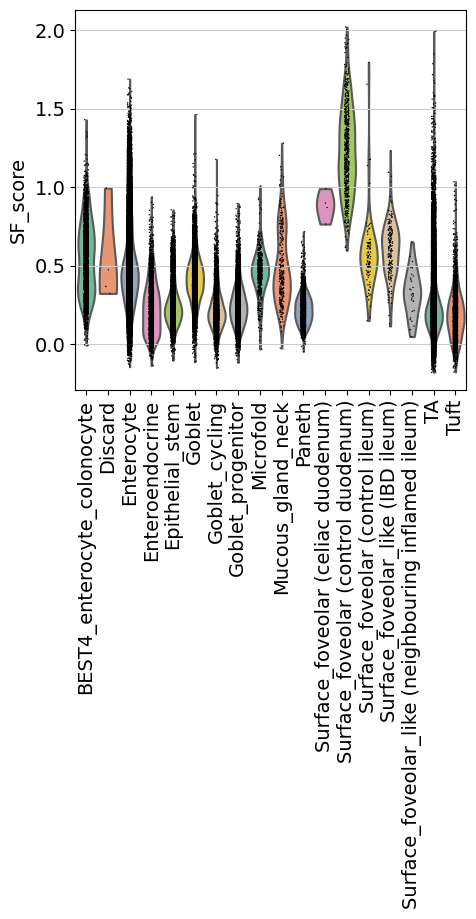

In [174]:
sc.pl.violin(adata,keys='SF_score',groupby='level_3_annot_SFplot',rotation=90,palette='Set2')

In [175]:
all_SF_up = ['ABCC3',
 'AHNAK',
 'AKR1B10',
 'CA2',
 'CAPN8',
 'CDHR2',
 'CYP2C18',
 'GCNT3',
 'GOLM1',
 'GPRC5A',
 'HPGD',
 'HSD17B2',
 'HSPB1',
 'IQGAP2',
 'MALL',
 'MT-CO2',
 'MT-ND5',
 'MTRNR2L12',
 'OSBPL7',
 'PLA2G10',
 'SERPINB6',
 'SGK1',
 'SLC25A37',
 'SLC26A3',
 'SLC4A4',
 'TFF1',
 'TRIM31',
 'VSIG2']

In [176]:
sc.tl.score_genes(adata, all_SF_up, ctrl_size=50, score_name='SFall_score')

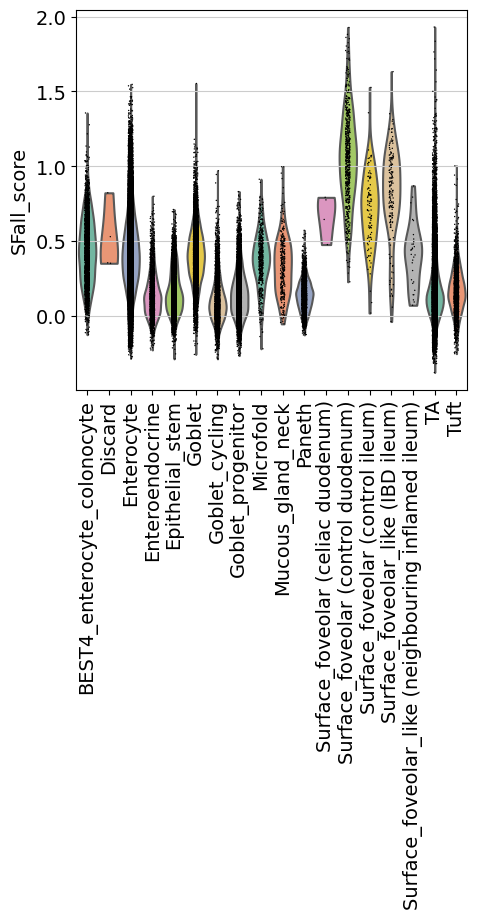

In [177]:
sc.pl.violin(adata,keys='SFall_score',groupby='level_3_annot_SFplot',rotation=90,palette='Set2')

In [178]:
plot_m5_final = adata[~adata.obs.level_3_annot_SFplot.isin(['Discard'])].copy()

In [179]:
sns.set_style(style="white")
sns.set_context(context="paper")

In [181]:
list(plot_m5_final.obs.level_3_annot_SFplot.unique())

['TA',
 'Microfold',
 'Enterocyte',
 'Epithelial_stem',
 'Goblet_cycling',
 'Goblet_progenitor',
 'BEST4_enterocyte_colonocyte',
 'Goblet',
 'Tuft',
 'Enteroendocrine',
 'Surface_foveolar (control ileum)',
 'Paneth',
 'Surface_foveolar (control duodenum)',
 'Mucous_gland_neck',
 'Surface_foveolar_like (neighbouring inflamed ileum)',
 'Surface_foveolar_like (IBD ileum)',
 'Surface_foveolar (celiac duodenum)']

In [182]:
plot_m5_final.obs['level_3_annot_SFplot'].cat.reorder_categories([
    
     'BEST4_enterocyte_colonocyte',
     'Enterocyte',
     'Enteroendocrine',
     'Epithelial_stem',
     'Goblet',
    'Goblet_cycling',
 'Goblet_progenitor',
    'Surface_foveolar (control duodenum)',
     'Surface_foveolar (celiac duodenum)',
     'Surface_foveolar (control ileum)',
    'Surface_foveolar_like (neighbouring inflamed ileum)',
    'Surface_foveolar_like (IBD ileum)',
     'Mucous_gland_neck',
      'Microfold',
     'Paneth',
    'TA',
 'Tuft'], inplace=True)

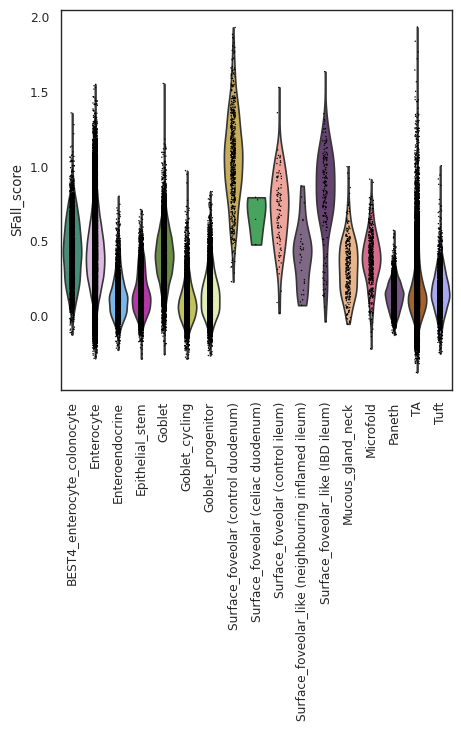

In [185]:
sc.pl.violin(plot_m5_final,keys='SFall_score',groupby='level_3_annot_SFplot',rotation=90,palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                                                                  '#c924b9',#stem
                                               
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                               
                                               '#d9b74a',#SF control duo
                                               '#38B257' ,#SF celiac duo
                                                        '#fc9a8d', #SF control ileum                                          
                                                '#82638a',#SF neighbouring inflamed
                                                '#693C78',#SF IBD                                     
                                               '#f7b37c',#MUC6
                                               
                                               '#e55b85',#Microfold
                                               '#79508f',#paneth
                                               
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
    
    
],save='SFall_genescore_commonupregbetweenduoandibd.pdf')

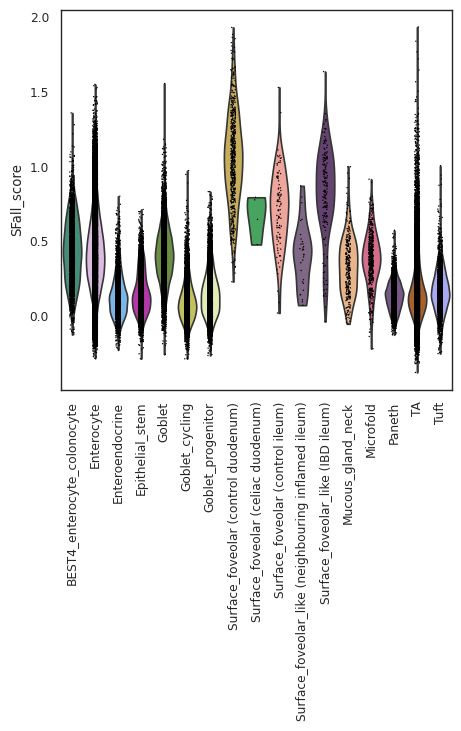

In [205]:
sc.pl.violin(plot_m5_final,keys='SFall_score',groupby='level_3_annot_SFplot',rotation=90,palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                                                                  '#c924b9',#stem
                                               
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                               
                                               '#d9b74a',#SF control duo
                                               '#38B257' ,#SF celiac duo
                                                        '#fc9a8d', #SF control ileum                                          
                                                '#82638a',#SF neighbouring inflamed
                                                '#693C78',#SF IBD                                     
                                               '#f7b37c',#MUC6
                                               
                                               '#e55b85',#Microfold
                                               '#79508f',#paneth
                                               
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
    
    
],save='SFall_genescore_commonupregbetweenduoandibd.png')

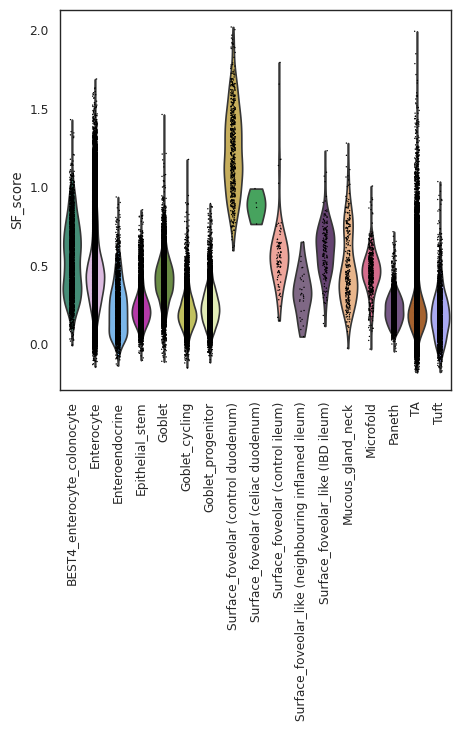

In [188]:
sc.pl.violin(plot_m5_final,keys='SF_score',groupby='level_3_annot_SFplot',rotation=90,palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                                                                  '#c924b9',#stem
                                               
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                               
                                               '#d9b74a',#SF control duo
                                               '#38B257' ,#SF celiac duo
                                                        '#fc9a8d', #SF control ileum                                          
                                                '#82638a',#SF neighbouring inflamed
                                                '#693C78',#SF IBD                                     
                                               '#f7b37c',#MUC6
                                               
                                               '#e55b85',#Microfold
                                               '#79508f',#paneth
                                               
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
    
    
],save='SF_genescore_top50duo.pdf')

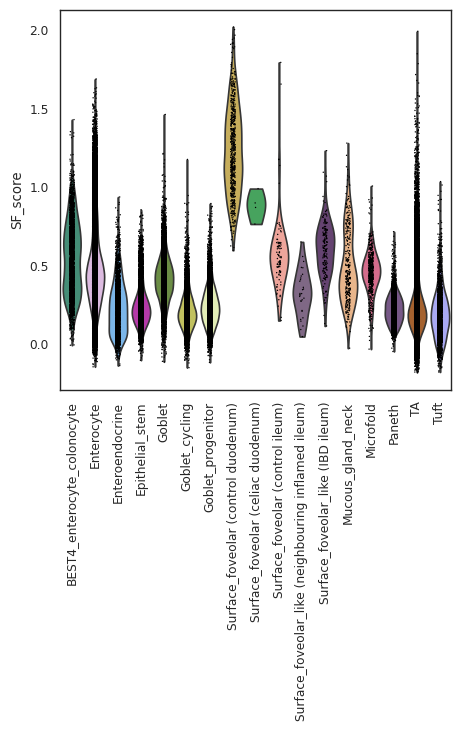

In [206]:
sc.pl.violin(plot_m5_final,keys='SF_score',groupby='level_3_annot_SFplot',rotation=90,palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                                                                  '#c924b9',#stem
                                               
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                               
                                               '#d9b74a',#SF control duo
                                               '#38B257' ,#SF celiac duo
                                                        '#fc9a8d', #SF control ileum                                          
                                                '#82638a',#SF neighbouring inflamed
                                                '#693C78',#SF IBD                                     
                                               '#f7b37c',#MUC6
                                               
                                               '#e55b85',#Microfold
                                               '#79508f',#paneth
                                               
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
    
    
],save='SF_genescore_top50duo.png')

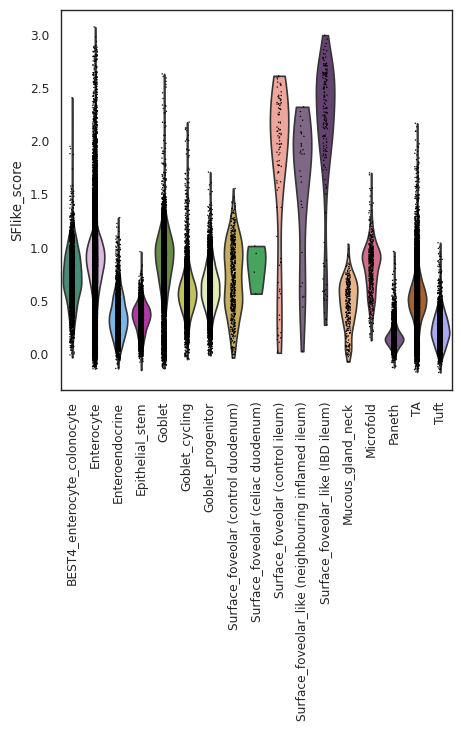

In [189]:
sc.pl.violin(plot_m5_final,keys='SFlike_score',groupby='level_3_annot_SFplot',rotation=90,palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                                                                  '#c924b9',#stem
                                               
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                               
                                               '#d9b74a',#SF control duo
                                               '#38B257' ,#SF celiac duo
                                                        '#fc9a8d', #SF control ileum                                          
                                                '#82638a',#SF neighbouring inflamed
                                                '#693C78',#SF IBD                                     
                                               '#f7b37c',#MUC6
                                               
                                               '#e55b85',#Microfold
                                               '#79508f',#paneth
                                               
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
    
    
],save='SFlike_genescore_top50ibd.pdf')

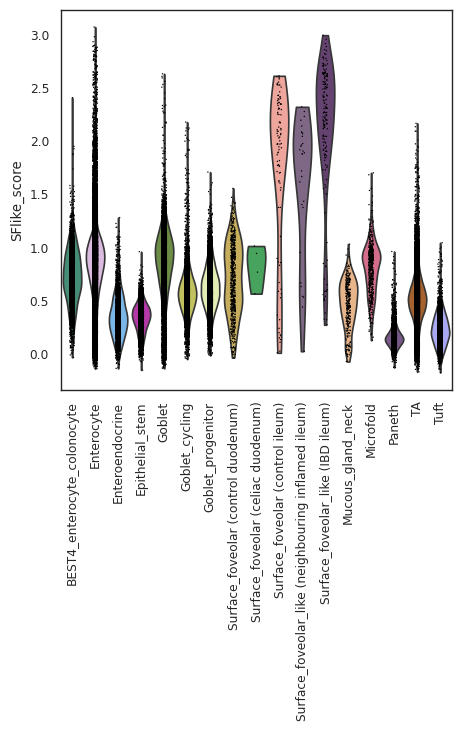

In [207]:
sc.pl.violin(plot_m5_final,keys='SFlike_score',groupby='level_3_annot_SFplot',rotation=90,palette=['#39997c',#BEST4
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                                                                  '#c924b9',#stem
                                               
                                               '#6c9939',#goblet
                                               '#d1d14f',#goblet_cycling
                                               '#e9f7ad',#goblet progenitor
                                               
                                               '#d9b74a',#SF control duo
                                               '#38B257' ,#SF celiac duo
                                                        '#fc9a8d', #SF control ileum                                          
                                                '#82638a',#SF neighbouring inflamed
                                                '#693C78',#SF IBD                                     
                                               '#f7b37c',#MUC6
                                               
                                               '#e55b85',#Microfold
                                               '#79508f',#paneth
                                               
                                              #'#ad1a55',#TA
                                               '#b85f1c',#TA cycling
                                               '#9d9dff',#tuft
    
    
],save='SFlike_genescore_top50ibd.png')

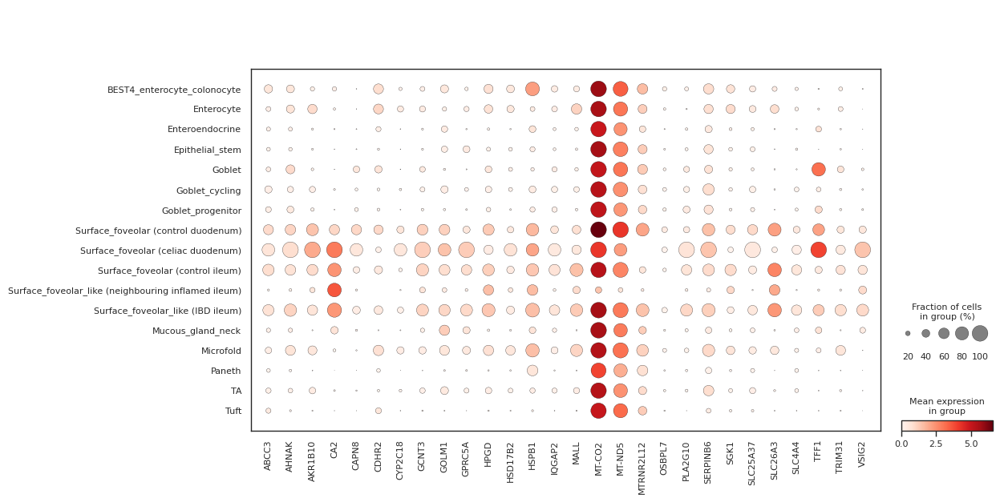

In [190]:
sc.pl.dotplot(plot_m5_final,var_names=all_SF_up,groupby='level_3_annot_SFplot')

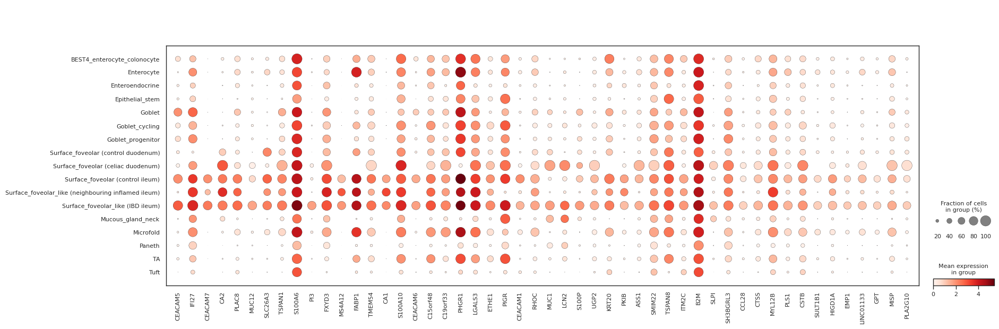

In [191]:
sc.pl.dotplot(plot_m5_final,var_names=genes_to_plot,groupby='level_3_annot_SFplot')

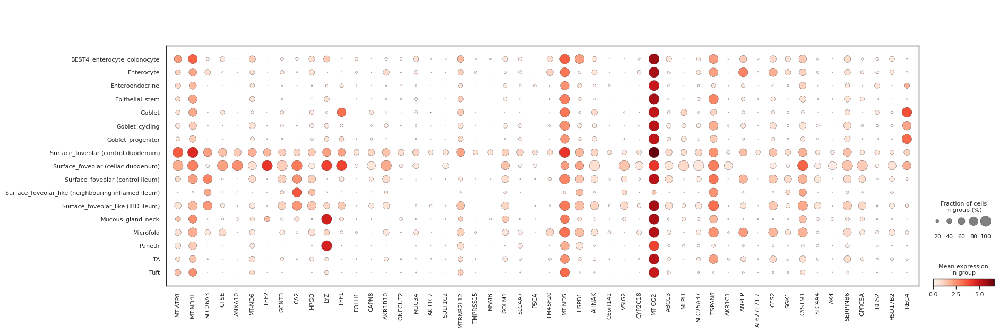

In [192]:
sc.pl.dotplot(plot_m5_final,var_names=duo_SFgenes,groupby='level_3_annot_SFplot')

In [196]:
all_SF_up

['ABCC3',
 'AHNAK',
 'AKR1B10',
 'CA2',
 'CAPN8',
 'CDHR2',
 'CYP2C18',
 'GCNT3',
 'GOLM1',
 'GPRC5A',
 'HPGD',
 'HSD17B2',
 'HSPB1',
 'IQGAP2',
 'MALL',
 'MT-CO2',
 'MT-ND5',
 'MTRNR2L12',
 'OSBPL7',
 'PLA2G10',
 'SERPINB6',
 'SGK1',
 'SLC25A37',
 'SLC26A3',
 'SLC4A4',
 'TFF1',
 'TRIM31',
 'VSIG2']

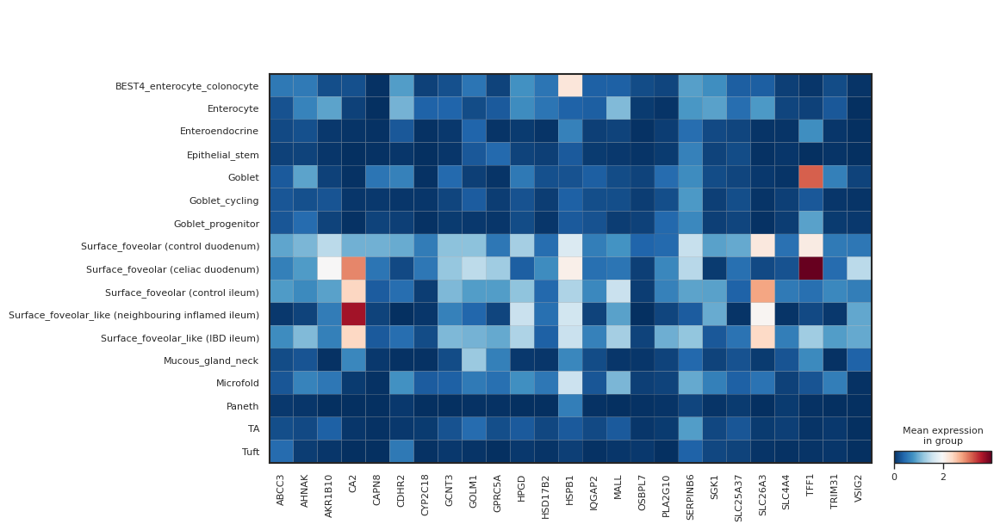

In [197]:
sc.pl.matrixplot(plot_m5_final,var_names=['ABCC3',
 'AHNAK',
 'AKR1B10',
 'CA2',
 'CAPN8',
 'CDHR2',
 'CYP2C18',
 'GCNT3',
 'GOLM1',
 'GPRC5A',
 'HPGD',
 'HSD17B2',
 'HSPB1',
 'IQGAP2',
 'MALL',
 'OSBPL7',
 'PLA2G10',
 'SERPINB6',
 'SGK1',
 'SLC25A37',
 'SLC26A3',
 'SLC4A4',
 'TFF1',
 'TRIM31',
 'VSIG2'],groupby='level_3_annot_SFplot',cmap='RdBu_r')

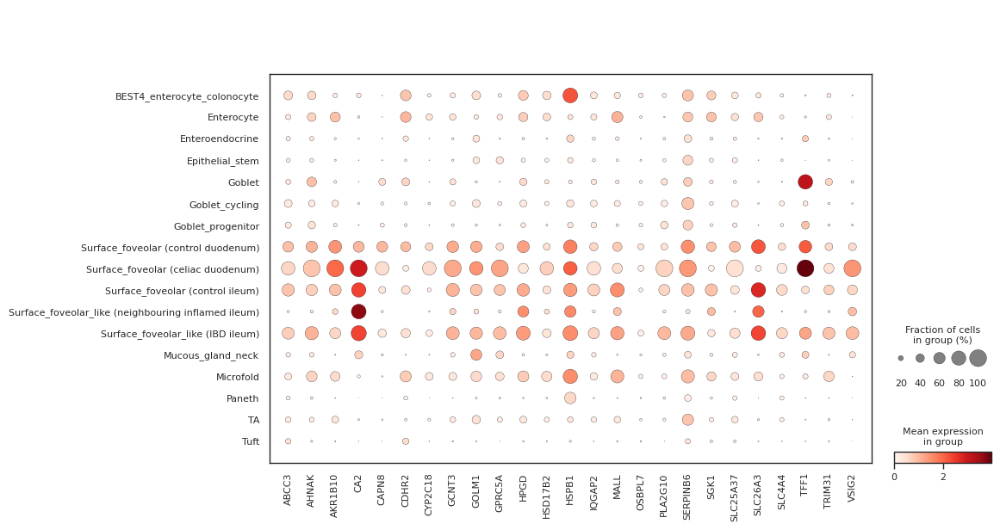

In [199]:
sc.pl.dotplot(plot_m5_final,var_names=['ABCC3',
 'AHNAK',
 'AKR1B10',
 'CA2',
 'CAPN8',
 'CDHR2',
 'CYP2C18',
 'GCNT3',
 'GOLM1',
 'GPRC5A',
 'HPGD',
 'HSD17B2',
 'HSPB1',
 'IQGAP2',
 'MALL',
 'OSBPL7',
 'PLA2G10',
 'SERPINB6',
 'SGK1',
 'SLC25A37',
 'SLC26A3',
 'SLC4A4',
 'TFF1',
 'TRIM31',
 'VSIG2'],groupby='level_3_annot_SFplot')

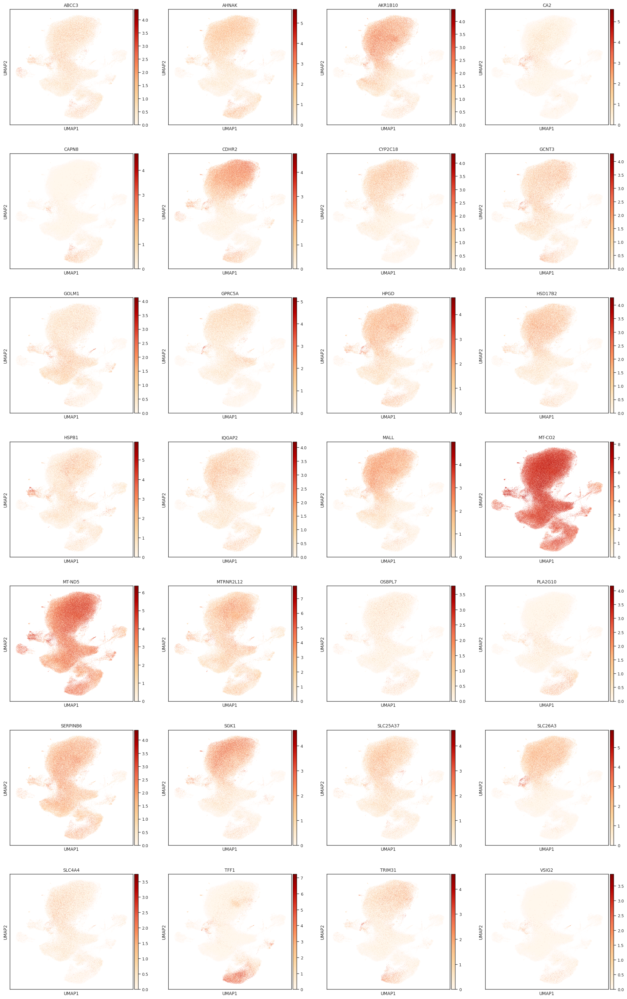

In [200]:
sc.pl.umap(adata,color=all_SF_up,cmap='OrRd')